<a href="https://colab.research.google.com/github/yingzibu/MOL2ADMET/blob/main/examples/experiments/ADMET_data_distribution_10_24.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Code

In [57]:
# from google.colab import drive
# drive.mount('/content/drive')

Mounted at /content/drive


In [66]:
# cd /content/drive/MyDrive/ADMET

/content/drive/MyDrive/ADMET


In [ ]:
! pip install rdkit --quiet
! pip install PyTDC --quiet
! pip install mycolorpy --quiet
! pip install molvs --quiet

In [65]:
import shutil
# path_prev = '/content/t-SNE/'
# new_path = shutil.move(path_prev, '/content/drive/MyDrive/ADMET/')
# print(new_path)
# temp/dir2/subdir

/content/drive/MyDrive/ADMET/t-SNE


In [64]:
# shutil.rmtree('/content/drive/MyDrive/ADMET/t-SNE')

In [4]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from sklearn.decomposition import PCA
import seaborn as sns
from sklearn.preprocessing import StandardScaler
import warnings
def warn(*args, **kwargs): pass
warnings.warn = warn

In [5]:
# from scripts.preprocess_mols import preprocess, rename_cols, clean_mol, scal

from rdkit import Chem
from rdkit.Chem.SaltRemover import SaltRemover
import pandas as pd
import numpy as np
from tqdm import tqdm
from molvs.normalize import Normalizer, Normalization
from molvs.charge import Reionizer, Uncharger

from rdkit import RDLogger
import warnings
RDLogger.DisableLog('rdApp.*')
warnings.filterwarnings("ignore")

def preprocess(smi):
    "Reference: https://github.com/Yimeng-Wang/JAK-MTATFP/blob/main/preprocess.py"
    try:
        mol = Chem.MolFromSmiles(smi)
        normalizer = Normalizer()
        new1 = normalizer.normalize(mol)
        remover = SaltRemover()
        new2 = remover(new1)
        neutralize1 = Reionizer()
        new3 = neutralize1(new2)
        neutralize2 = Uncharger()
        new4 = neutralize2(new3)
        new_smiles = Chem.MolToSmiles(new4, kekuleSmiles=False)
        if new4!=None: return new_smiles
        else: return None
    except: return None

def rename_cols(df, name): return df.rename(columns={'Y':name})

def clean_mol(df:pd.DataFrame):
    prev_len = len(df)
    drop_idxs = []
    for i in tqdm(range(len(df)), total=len(df), desc='Cleaning mols'):
        try:
            df.iloc[i]['Drug'] = preprocess(df.iloc[i]['Drug'])
            if pd.isna(df.iloc[i]['Drug']) or df.iloc[i]['Drug']==None:
                drop_idxs.append(i)
        except: drop_idxs.append(i)
    for i in drop_idxs: df = df.drop(i)
    if len(df) != prev_len: print(f'prev len: {prev_len}; after clean: {len(df)}')
    try: assert df['Drug'].isnull().values.any() == False
    except: print('There are nan in Drug column')
    return df.reset_index(drop=True)

def scal(df, min_here=None, max_here=None): # min max scaling
    # df_norm = df.loc[:, df.columns!='Drug'].copy()
    df_norm = df.copy()
    for col in df_norm.columns:
        if col == 'Drug': pass
        else:
            if min_here == None or max_here == None:
                min_here = df_norm[col].min()
                max_here = df_norm[col].max()
            df_norm[col] = (df_norm[col]-min_here
            )/(max_here - min_here) * 10 + 1e-3
    # df_norm['Drug'] = df['Drug']
    return df_norm

from tdc.single_pred import ADME
def collect_data(names:list, IS_R, SCALE=False, type_tdc='ADME'):
    for i, name in enumerate(names):
        print('*'*15, name, '*'*15)
        if type_tdc == 'ADME':
            data = ADME(name=name)
            # data.label_distribution()
            split = data.get_split()
        train, valid = clean_mol(split['train']), clean_mol(split['valid'])
        test =  clean_mol(split['test'])

        train = rename_cols(train[['Drug', 'Y']], name)
        valid = rename_cols(valid[['Drug', 'Y']], name)
        test  = rename_cols(test[['Drug', 'Y']],  name)

        if IS_R and SCALE: train, valid, test = scal(train), scal(valid), scal(test)

        if i == 0: trains, valids, tests = train, valid, test
        else:
            trains = trains.merge(train, how='outer')
            valids = valids.merge(valid, how='outer')
            tests = tests.merge(test, how='outer')
    return trains, valids, tests


In [6]:
from tdc.single_pred import ADME
from tdc.single_pred import Tox
from tdc.utils import retrieve_label_name_list

label_list = retrieve_label_name_list('herg_central')

def collect_data_10_24(names:list, clean_mol_=False, show_dist=True):

    names_ADME = ['Caco2_Wang', 'Lipophilicity_AstraZeneca',
              'HydrationFreeEnergy_FreeSolv', 'Solubility_AqSolDB',
              'CYP2C19_Veith', 'CYP2D6_Veith', 'CYP3A4_Veith',
              'CYP1A2_Veith', 'CYP2C9_Veith', 'BBB_Martins',
              'Bioavailability_Ma', 'Pgp_Broccatelli', 'HIA_Hou','PAMPA_NCATS']

    for i, name in enumerate(names):
        # print('*'*15, name, '*'*15)
        if name in label_list:
            data = Tox(name='herg_central', label_name=name)
        else:
            if name in names_ADME: data = ADME(name=name)
            else:
                try: data = Tox(name=name)
                except: print('cannot read data!'); return
            if show_dist: data.label_distribution()
        split = data.get_split()
        train, valid, test = split['train'], split['valid'], split['test']
        if clean_mol_:
            train, valid, test = clean_mol(train), clean_mol(valid), clean_mol(test)

        train = rename_cols(train[['Drug', 'Y']], name)
        valid = rename_cols(valid[['Drug', 'Y']], name)
        test  = rename_cols(test[['Drug', 'Y']],  name)

        if i == 0:
            trains, valids, tests = train.copy(), valid.copy(), test.copy()
        else:
            trains = trains.merge(train, how='outer')
            valids = valids.merge(valid, how='outer')
            tests = tests.merge(test, how='outer')

    return trains, valids, tests

# EXAMPLE CODE
# trains, valids, tests = collect_data_10_24(['Caco2_Wang'], show_dist=False)

In [7]:
import pandas as pd
from mycolorpy import colorlist as mcp
def count_(df:pd.DataFrame):
    for col in df.columns:
        if col != 'Drug':
            try:
                ones = df[col].value_counts()[1]
                zero = df[col].value_counts()[0]
            except: ones = 'Nan'; zero = 'Nan'
            print(col, f'\t 0: {zero} | 1: {ones} | total: {zero+ones}')

def scale(trains, valids, tests):
    print('scaling train valid test data set for regression task ')
    dict_scale = {}
    for col in trains.columns:
        if col == 'Drug': pass
        else:
            # print(col)
            min_here = min(trains[col].min(), valids[col].min(), tests[col].min())
            max_here = max(trains[col].max(), valids[col].max(), tests[col].max())
            dict_scale[col] = [min_here, max_here]
            delta_here = max_here - min_here
            trains[col] = (trains[col] - min_here) / delta_here
            valids[col] = (valids[col] - min_here) / delta_here
            tests[col]  = (tests[col]  - min_here) / delta_here

    return trains, valids, tests, dict_scale

In [10]:
import pandas as pd
import rdkit
from rdkit import Chem
from rdkit.Chem.MACCSkeys import GenMACCSKeys

m = Chem.MolFromSmiles
header = ['bit' + str(i) for i in range(167)]

def smile_list_to_MACCS(smi_list:list):
    MACCS_list = []
    for smi in smi_list:
        maccs = [float(i) for i in list(GenMACCSKeys(m(smi)).ToBitString())]
        MACCS_list.append(maccs)
    return MACCS_list

def process(data_):
    data = data_.copy()
    # data = convert_with_qed_sa(data)
    print('---> converting SMILES to MACCS...')
    MACCS_list = smile_list_to_MACCS(data['Drug'].tolist())
    data[header] = pd.DataFrame(MACCS_list)
    print('---> FINISHED')
    return data

def make_path(path_name, verbose=True):
    import os
    if os.path.exists(path_name):
        if verbose: print('path:', path_name, 'already exists')
    else: os.makedirs(path_name); print('path:', path_name, 'is created')


In [44]:
from sklearn.manifold import TSNE
from sklearn.preprocessing import MinMaxScaler

def plot_dim_reduced(mol_info, label, task_type, dim_reduct='PCA', title=None):
    """
    param mol_info: could be MACCS Fingerprint
    param label: label of data
    param task_type: [True, False], True:regression; False: classification
    param dim_reduct" : ['PCA', 't-SNE']
    param title: None or string, the name of the plot
    Return figure.png saved at dim_reduct/title.png
    """
    features, labels = mol_info.copy(), label.copy()
    n_components = 2
    if dim_reduct == 'PCA':
        pca = PCA(n_components=n_components)
        pca.fit(features)
        features = StandardScaler().fit_transform(features)
        features = pd.DataFrame(data = pca.transform(features))
        ax_label = 'principle component'
    elif dim_reduct=='t-SNE':
        features = TSNE(n_components=n_components).fit_transform(features)
        features = MinMaxScaler().fit_transform(features)
        features = pd.DataFrame(np.transpose((features[:,0],features[:,1])))
        ax_label = 'tnse'
    else: print("""Error! dim_reduct should be 'PCA' or 't-SNE'"""); return

    columns = [f'{ax_label} {i+1}' for i in range(n_components)]
    # features = pd.DataFrame(data = pca.transform(features), columns=columns)
    features.columns = columns
    features['label'] = labels

    sns.set_theme(style="whitegrid")
    # f, ax = plt.subplots(figsize=(6, 6))
    f, ax = plt.subplots()


    param_dict = {'x': columns[0],
                'y': columns[1],
                'hue':'label',
                'palette': 'RdBu',
                'data': features,
                's': 10,
                'ax':ax}

    # sns.despine(f, left=True, bottom=False)
    sns.scatterplot(**param_dict)


    if task_type == True: # regression task, color bar for labels
        norm = plt.Normalize(labels.min(), labels.max())
        scalarmap = plt.cm.ScalarMappable(cmap=param_dict['palette'], norm=norm)
        scalarmap.set_array([])
        ax.figure.colorbar(scalarmap)
        ax.get_legend().remove()
    else: sns.move_legend(ax, 'upper right') # for classification, label box

    ax = plt.gca()
    # Set the border or outline color and width
    border_color = 'black'
    border_width = 0.6  # Adjust this as needed

    # Add a rectangular border around the plot
    for i in ['top', 'right', 'bottom', 'left']: ax.spines[i].set_visible(True)

    for spine in ax.spines.values():
        spine.set_linewidth(border_width); spine.set_color(border_color)
    # move the legend if has that:


    if title == None: title = f'{dim_reduct}_demo'
    plt.title(title); make_path(dim_reduct, False)
    plt.savefig(f'{dim_reduct}/{title}.png', format='png', transparent=True)
    print(f'figure saved at {dim_reduct}/{title}.png')
    plt.show(); plt.close()


"""TEST CODE"""
# name = 'HIA_Hou'; IS_R = False
# # name = 'Caco2_Wang'; IS_R = True
# trains, valids, tests = collect_data_10_24([name], show_dist=False)
# df_all   = pd.concat([trains, valids, tests], ignore_index=True, axis=0)
# data_list = [trains, valids, tests, df_all]
# desc_list = ['train set', 'valid set', 'test set', 'data set']
# for (data, desc) in zip(data_list, desc_list):
#     data = process(data)
#     features, labels = data[header], data[name]
#     assert features.shape[0] == len(labels)
#     for dim_reduct in ['PCA', 't-SNE']:
#         title = f'{dim_reduct} on {desc} of {name}'
#         if dim_reduct == 'PCA':
#             plot_dim_reduced(features, labels, IS_R, dim_reduct, title)

'TEST CODE'

## Data distribution information

https://github.com/yingzibu/MOL2ADMET/tree/main

In [20]:
names_dict = {}
names_reg = ['Caco2_Wang', 'Lipophilicity_AstraZeneca',
         'HydrationFreeEnergy_FreeSolv', 'Solubility_AqSolDB', 'LD50_Zhu'] # regression task
names_cls = ['CYP2C19_Veith', 'CYP2D6_Veith', 'CYP3A4_Veith',
             'CYP1A2_Veith', 'CYP2C9_Veith'] + \
            ['BBB_Martins', 'Bioavailability_Ma',
             'Pgp_Broccatelli', 'HIA_Hou','PAMPA_NCATS'] + \
            ['hERG_Karim', 'AMES']

for name in names_reg + names_cls:
    if name in names_reg:   names_dict[name] = True  # regression task
    elif name in names_cls: names_dict[name] = False # classification task

for name, is_r in names_dict.items():
    if is_r: ty = 'Regression'
    else: ty = 'Classification'
    print(f'{name},\t {ty} task')

Caco2_Wang,	 Regression task
Lipophilicity_AstraZeneca,	 Regression task
HydrationFreeEnergy_FreeSolv,	 Regression task
Solubility_AqSolDB,	 Regression task
LD50_Zhu,	 Regression task
CYP2C19_Veith,	 Classification task
CYP2D6_Veith,	 Classification task
CYP3A4_Veith,	 Classification task
CYP1A2_Veith,	 Classification task
CYP2C9_Veith,	 Classification task
BBB_Martins,	 Classification task
Bioavailability_Ma,	 Classification task
Pgp_Broccatelli,	 Classification task
HIA_Hou,	 Classification task
PAMPA_NCATS,	 Classification task
hERG_Karim,	 Classification task
AMES,	 Classification task


Downloading...


********************************************************************************
****************************** Caco2_Wang ******************************
********************************************************************************


100%|██████████| 82.5k/82.5k [00:00<00:00, 1.54MiB/s]
Loading...
Done!


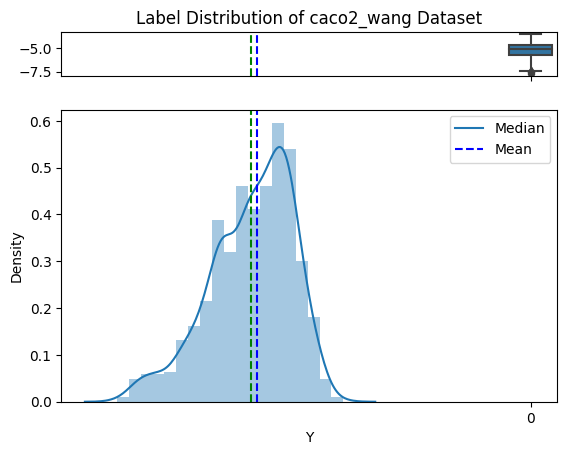

Downloading...


train: 637 | valid: 91 | test: 182 | total: 910
scaling train valid test data set for regression task 
min , max value for: {'Caco2_Wang': [-7.7600002, -3.51]}






********************************************************************************
****************************** Lipophilicity_AstraZeneca ******************************
********************************************************************************


100%|██████████| 298k/298k [00:00<00:00, 3.17MiB/s]
Loading...
Done!


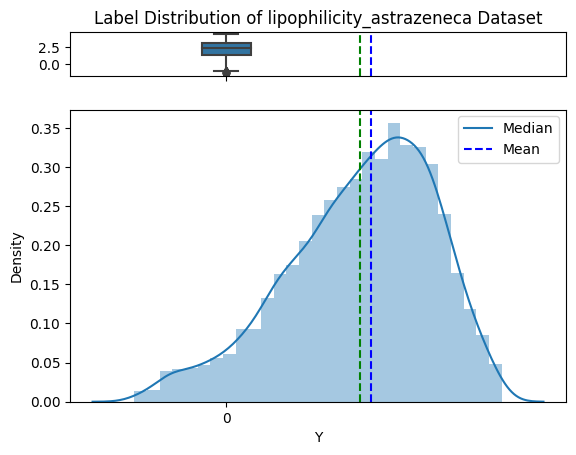

Downloading...


train: 2940 | valid: 420 | test: 840 | total: 4200
scaling train valid test data set for regression task 
min , max value for: {'Lipophilicity_AstraZeneca': [-1.5, 4.5]}






********************************************************************************
****************************** HydrationFreeEnergy_FreeSolv ******************************
********************************************************************************


100%|██████████| 29.0k/29.0k [00:00<00:00, 3.19MiB/s]
Loading...
Done!


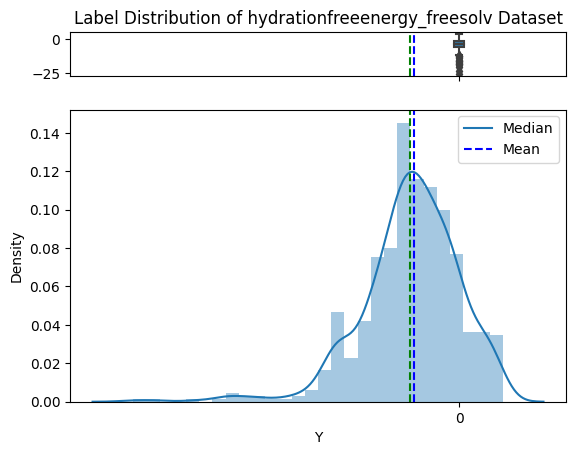

Downloading...


train: 450 | valid: 64 | test: 128 | total: 642
scaling train valid test data set for regression task 
min , max value for: {'HydrationFreeEnergy_FreeSolv': [-25.47, 3.43]}






********************************************************************************
****************************** Solubility_AqSolDB ******************************
********************************************************************************


100%|██████████| 853k/853k [00:00<00:00, 6.79MiB/s]
Loading...
Done!


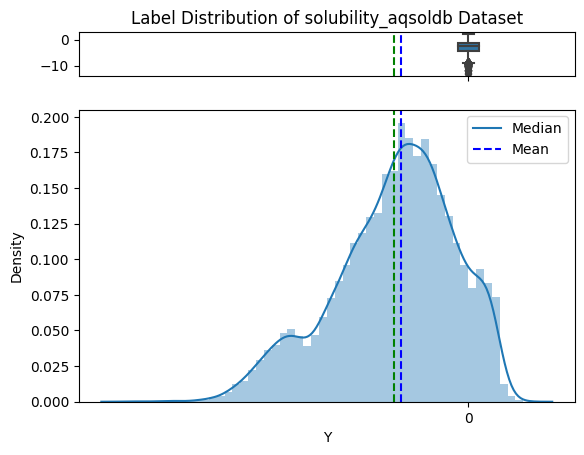

Downloading...


train: 6988 | valid: 998 | test: 1996 | total: 9982
scaling train valid test data set for regression task 
min , max value for: {'Solubility_AqSolDB': [-13.1719, 2.1376816201]}






********************************************************************************
****************************** LD50_Zhu ******************************
********************************************************************************


100%|██████████| 707k/707k [00:00<00:00, 4.91MiB/s]
Loading...
Done!


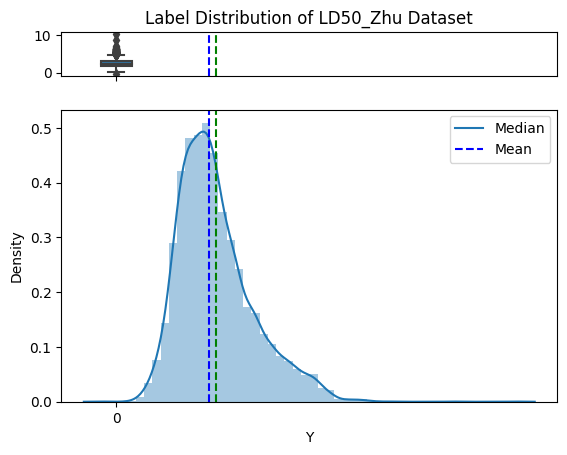

Downloading...


train: 5170 | valid: 738 | test: 1477 | total: 7385
scaling train valid test data set for regression task 
min , max value for: {'LD50_Zhu': [-0.3429999999999999, 10.207]}






********************************************************************************
****************************** CYP2C19_Veith ******************************
********************************************************************************


100%|██████████| 771k/771k [00:00<00:00, 6.51MiB/s]
Loading...
Done!


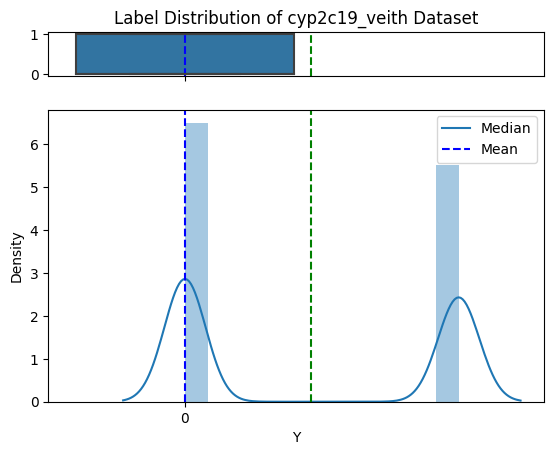

Downloading...


train: 8866 | valid: 1266 | test: 2533 | total: 12665
******************** train ********************
CYP2C19_Veith 	 0: 4803 | 1: 4063 | total: 8866
******************** valid ********************
CYP2C19_Veith 	 0: 673 | 1: 593 | total: 1266
******************** test ********************
CYP2C19_Veith 	 0: 1370 | 1: 1163 | total: 2533






********************************************************************************
****************************** CYP2D6_Veith ******************************
********************************************************************************


100%|██████████| 800k/800k [00:00<00:00, 5.88MiB/s]
Loading...
Done!


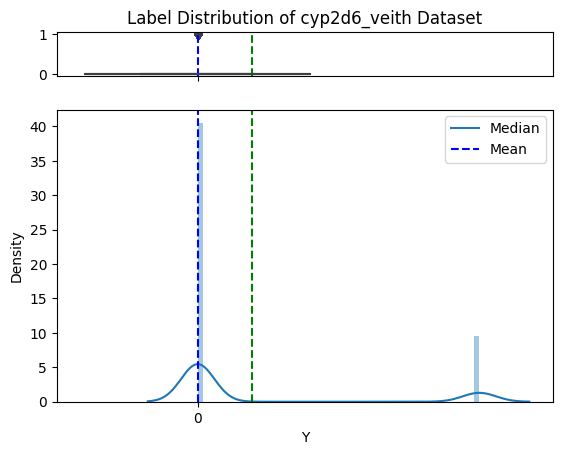

Downloading...


train: 9191 | valid: 1313 | test: 2626 | total: 13130
******************** train ********************
CYP2D6_Veith 	 0: 7425 | 1: 1766 | total: 9191
******************** valid ********************
CYP2D6_Veith 	 0: 1053 | 1: 260 | total: 1313
******************** test ********************
CYP2D6_Veith 	 0: 2138 | 1: 488 | total: 2626






********************************************************************************
****************************** CYP3A4_Veith ******************************
********************************************************************************


100%|██████████| 746k/746k [00:00<00:00, 4.89MiB/s]
Loading...
Done!


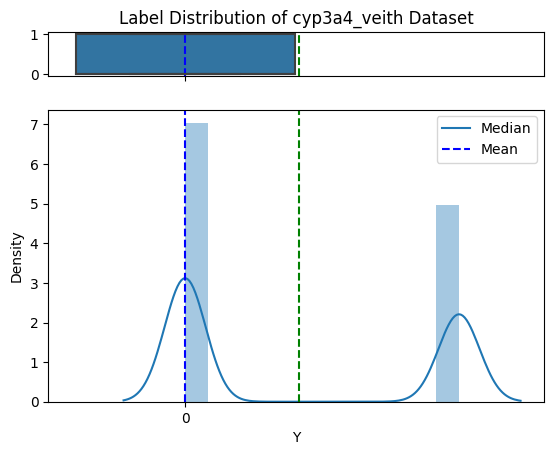

Downloading...


train: 8629 | valid: 1233 | test: 2466 | total: 12328
******************** train ********************
CYP3A4_Veith 	 0: 5052 | 1: 3577 | total: 8629
******************** valid ********************
CYP3A4_Veith 	 0: 717 | 1: 516 | total: 1233
******************** test ********************
CYP3A4_Veith 	 0: 1449 | 1: 1017 | total: 2466






********************************************************************************
****************************** CYP1A2_Veith ******************************
********************************************************************************


100%|██████████| 760k/760k [00:00<00:00, 5.59MiB/s]
Loading...
Done!


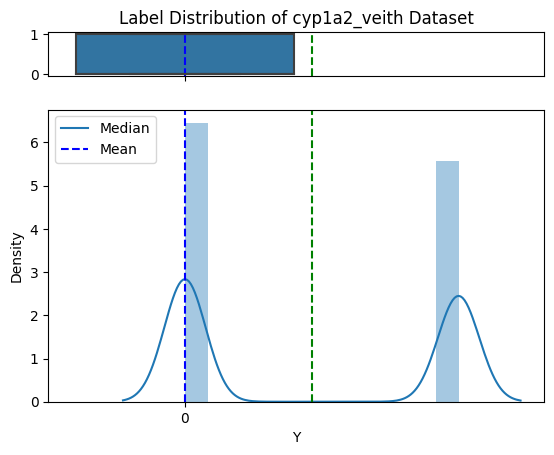

Downloading...


train: 8805 | valid: 1258 | test: 2516 | total: 12579
******************** train ********************
CYP1A2_Veith 	 0: 4745 | 1: 4060 | total: 8805
******************** valid ********************
CYP1A2_Veith 	 0: 677 | 1: 581 | total: 1258
******************** test ********************
CYP1A2_Veith 	 0: 1328 | 1: 1188 | total: 2516






********************************************************************************
****************************** CYP2C9_Veith ******************************
********************************************************************************


100%|██████████| 740k/740k [00:00<00:00, 5.60MiB/s]
Loading...
Done!


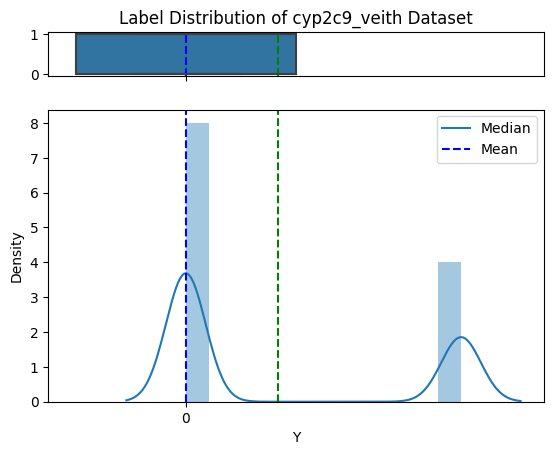

Downloading...


train: 8465 | valid: 1209 | test: 2418 | total: 12092
******************** train ********************
CYP2C9_Veith 	 0: 5652 | 1: 2813 | total: 8465
******************** valid ********************
CYP2C9_Veith 	 0: 796 | 1: 413 | total: 1209
******************** test ********************
CYP2C9_Veith 	 0: 1599 | 1: 819 | total: 2418






********************************************************************************
****************************** BBB_Martins ******************************
********************************************************************************


100%|██████████| 138k/138k [00:00<00:00, 2.68MiB/s]
Loading...
Done!


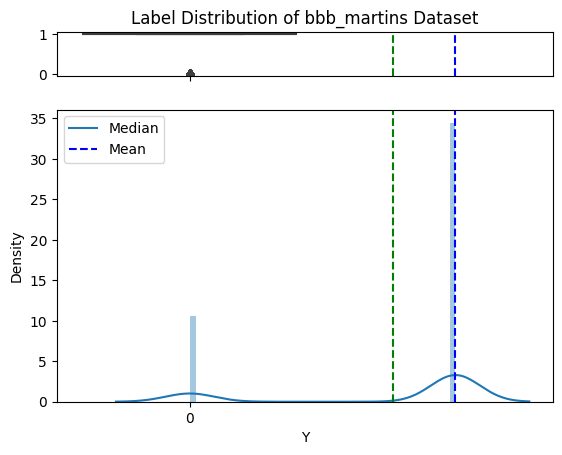

Downloading...


train: 1421 | valid: 203 | test: 406 | total: 2030
******************** train ********************
BBB_Martins 	 0: 325 | 1: 1096 | total: 1421
******************** valid ********************
BBB_Martins 	 0: 51 | 1: 152 | total: 203
******************** test ********************
BBB_Martins 	 0: 103 | 1: 303 | total: 406






********************************************************************************
****************************** Bioavailability_Ma ******************************
********************************************************************************


100%|██████████| 43.7k/43.7k [00:00<00:00, 1.82MiB/s]
Loading...
Done!


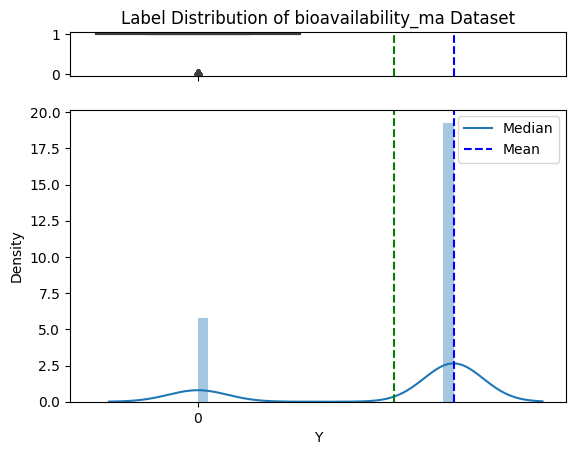

Downloading...


train: 448 | valid: 64 | test: 128 | total: 640
******************** train ********************
Bioavailability_Ma 	 0: 97 | 1: 351 | total: 448
******************** valid ********************
Bioavailability_Ma 	 0: 13 | 1: 51 | total: 64
******************** test ********************
Bioavailability_Ma 	 0: 38 | 1: 90 | total: 128






********************************************************************************
****************************** Pgp_Broccatelli ******************************
********************************************************************************


100%|██████████| 126k/126k [00:00<00:00, 2.25MiB/s]
Loading...
Done!


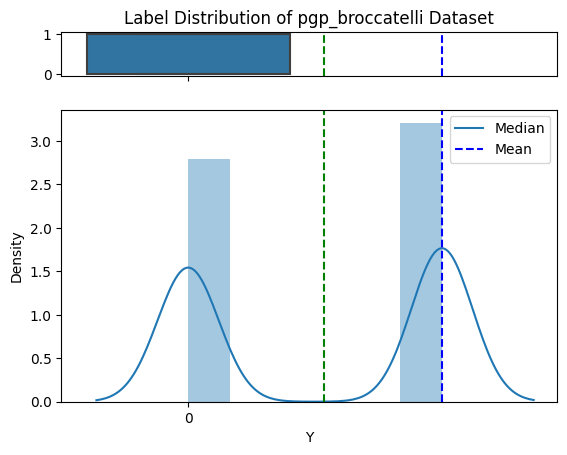

Downloading...


train: 852 | valid: 122 | test: 244 | total: 1218
******************** train ********************
Pgp_Broccatelli 	 0: 391 | 1: 461 | total: 852
******************** valid ********************
Pgp_Broccatelli 	 0: 56 | 1: 66 | total: 122
******************** test ********************
Pgp_Broccatelli 	 0: 121 | 1: 123 | total: 244






********************************************************************************
****************************** HIA_Hou ******************************
********************************************************************************


100%|██████████| 40.1k/40.1k [00:00<00:00, 3.09MiB/s]
Loading...
Done!


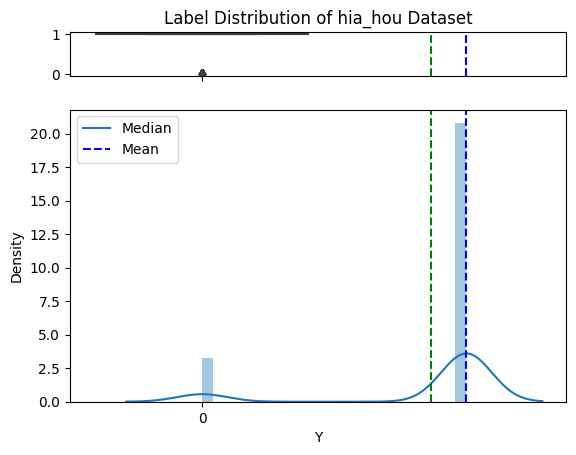

Downloading...


train: 404 | valid: 58 | test: 116 | total: 578
******************** train ********************
HIA_Hou 	 0: 53 | 1: 351 | total: 404
******************** valid ********************
HIA_Hou 	 0: 6 | 1: 52 | total: 58
******************** test ********************
HIA_Hou 	 0: 19 | 1: 97 | total: 116






********************************************************************************
****************************** PAMPA_NCATS ******************************
********************************************************************************


100%|██████████| 144k/144k [00:00<00:00, 1.56MiB/s]
Loading...
Done!


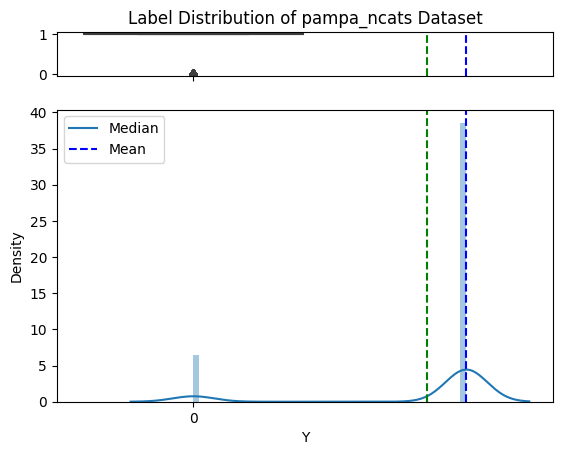

Downloading...


train: 1424 | valid: 203 | test: 407 | total: 2034
******************** train ********************
PAMPA_NCATS 	 0: 199 | 1: 1225 | total: 1424
******************** valid ********************
PAMPA_NCATS 	 0: 33 | 1: 170 | total: 203
******************** test ********************
PAMPA_NCATS 	 0: 63 | 1: 344 | total: 407






********************************************************************************
****************************** hERG_Karim ******************************
********************************************************************************


100%|██████████| 885k/885k [00:00<00:00, 5.23MiB/s]
Loading...
Done!


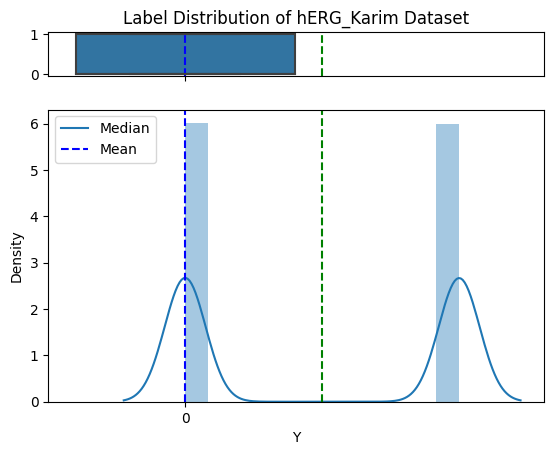

Downloading...


train: 9412 | valid: 1344 | test: 2689 | total: 13445
******************** train ********************
hERG_Karim 	 0: 4698 | 1: 4714 | total: 9412
******************** valid ********************
hERG_Karim 	 0: 683 | 1: 661 | total: 1344
******************** test ********************
hERG_Karim 	 0: 1346 | 1: 1343 | total: 2689






********************************************************************************
****************************** AMES ******************************
********************************************************************************


100%|██████████| 344k/344k [00:00<00:00, 2.51MiB/s]
Loading...
Done!


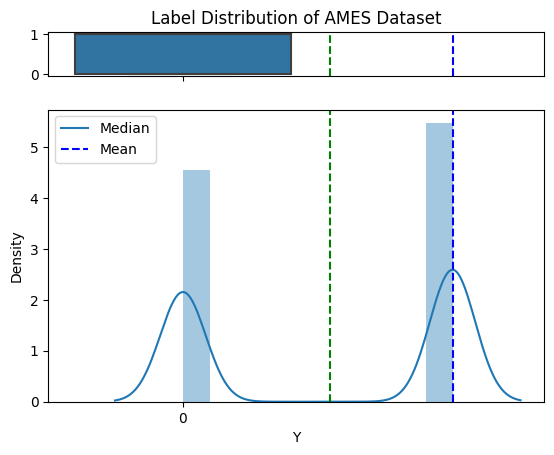

train: 5094 | valid: 728 | test: 1456 | total: 7278
******************** train ********************
AMES 	 0: 2335 | 1: 2759 | total: 5094
******************** valid ********************
AMES 	 0: 311 | 1: 417 | total: 728
******************** test ********************
AMES 	 0: 658 | 1: 798 | total: 1456








In [9]:
for name, task_type in names_dict.items():
    print('*'*80)
    print('*'*30, name, '*'*30)
    print('*'*80)
    trains, valids, tests = collect_data_10_24([name])
    print(f'train: {len(trains)} | valid: {len(valids)} | test: {len(tests)} | '
          f'total: {len(trains) + len(valids) + len(tests)}')
    if task_type == False: # classification
        print('*'*20, 'train', '*'*20)
        count_(trains)
        print('*'*20, 'valid', '*'*20)
        count_(valids)
        print('*'*20, 'test', '*'*20)
        count_(tests)
    if task_type == True: # regression
        _, _, _, scale_dict = scale(trains, valids, tests)
        print('min , max value for:', scale_dict)
    print('\n\n\n\n\n')

## PCA and t-SNE analysis

The following code will create 2 folders PCA/ and t-SNE/

Check folder for PCA and t-SNE plots

for each task, there are:

    4 PCA   plots: train set, valid set, test set and data set, in which data set is the sum of train,valid,test

    4 t-SNE plots: similarly

Found local copy...
Loading...
Done!


---> converting SMILES to MACCS...
---> FINISHED
path: PCA is created
figure saved at PCA/PCA on train set of Caco2_Wang.png


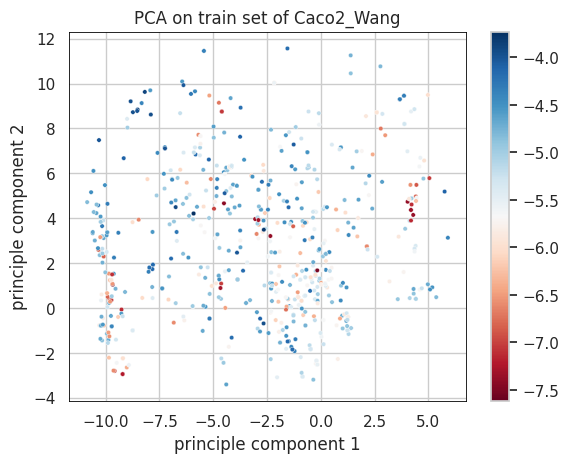

---> converting SMILES to MACCS...
---> FINISHED
figure saved at PCA/PCA on valid set of Caco2_Wang.png


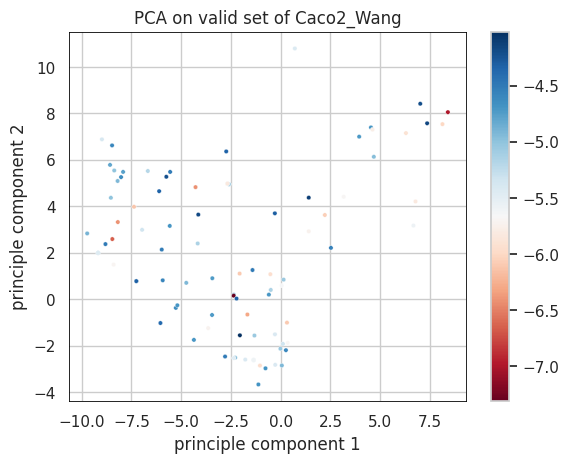

---> converting SMILES to MACCS...
---> FINISHED
figure saved at PCA/PCA on test set of Caco2_Wang.png


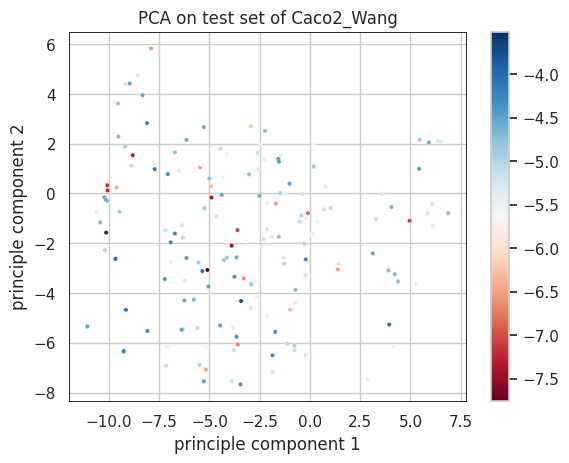

---> converting SMILES to MACCS...
---> FINISHED
figure saved at PCA/PCA on data set of Caco2_Wang.png


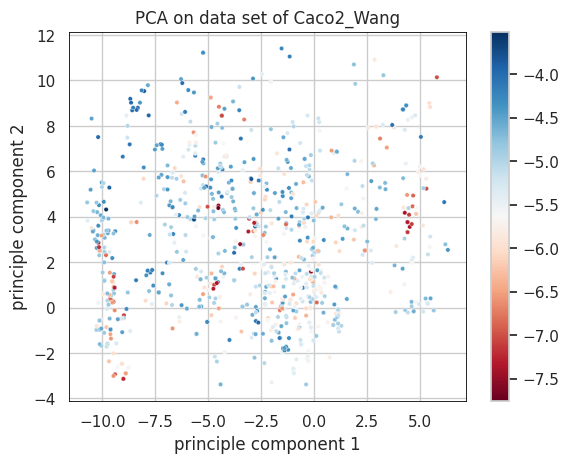

Found local copy...
Loading...
Done!


---> converting SMILES to MACCS...
---> FINISHED
figure saved at PCA/PCA on train set of Lipophilicity_AstraZeneca.png


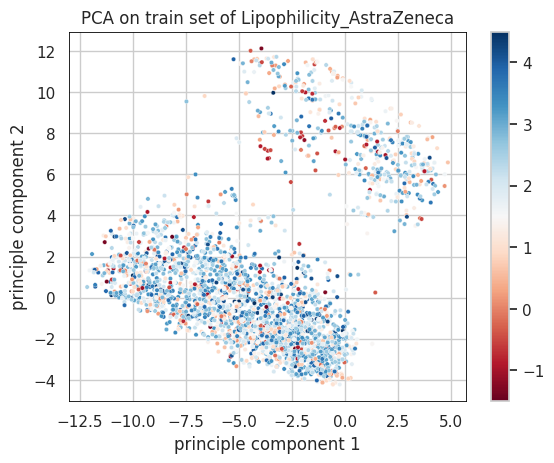

---> converting SMILES to MACCS...
---> FINISHED
figure saved at PCA/PCA on valid set of Lipophilicity_AstraZeneca.png


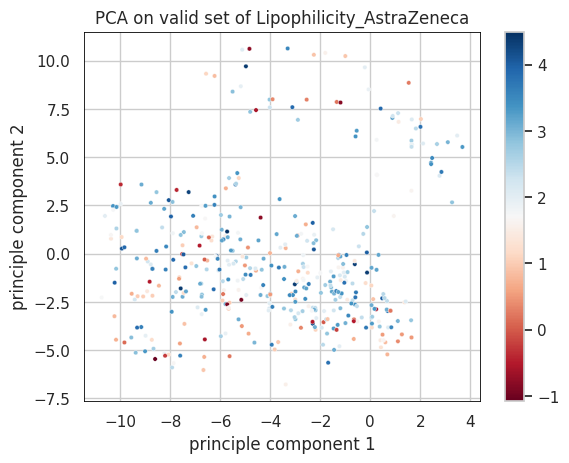

---> converting SMILES to MACCS...
---> FINISHED
figure saved at PCA/PCA on test set of Lipophilicity_AstraZeneca.png


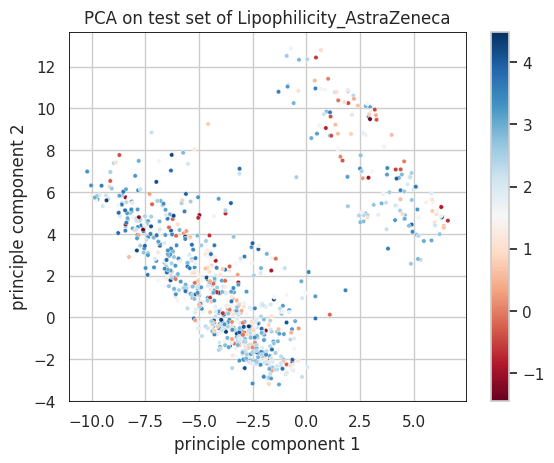

---> converting SMILES to MACCS...
---> FINISHED
figure saved at PCA/PCA on data set of Lipophilicity_AstraZeneca.png


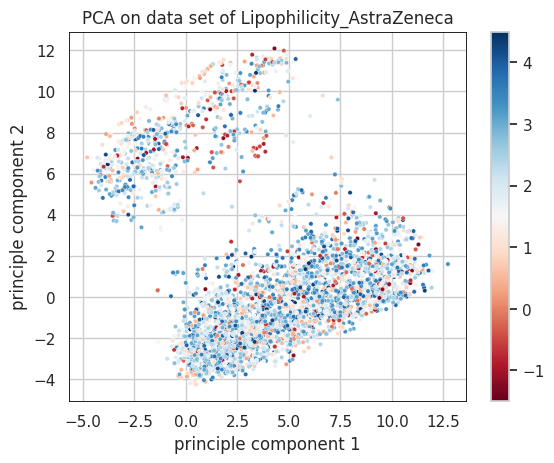

Found local copy...
Loading...
Done!


---> converting SMILES to MACCS...
---> FINISHED
figure saved at PCA/PCA on train set of HydrationFreeEnergy_FreeSolv.png


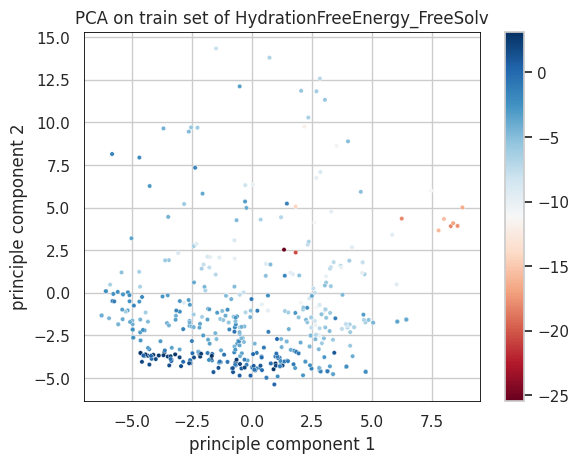

---> converting SMILES to MACCS...
---> FINISHED
figure saved at PCA/PCA on valid set of HydrationFreeEnergy_FreeSolv.png


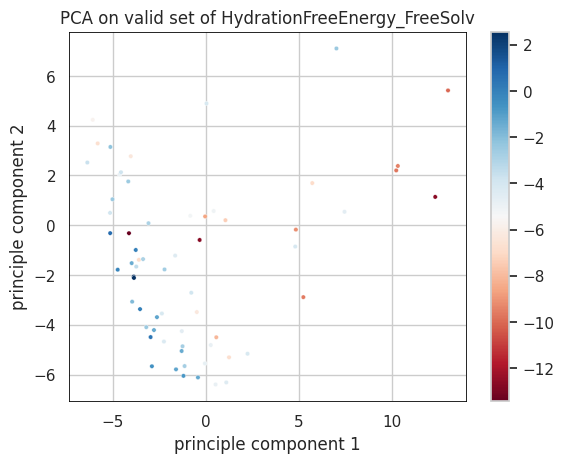

---> converting SMILES to MACCS...
---> FINISHED
figure saved at PCA/PCA on test set of HydrationFreeEnergy_FreeSolv.png


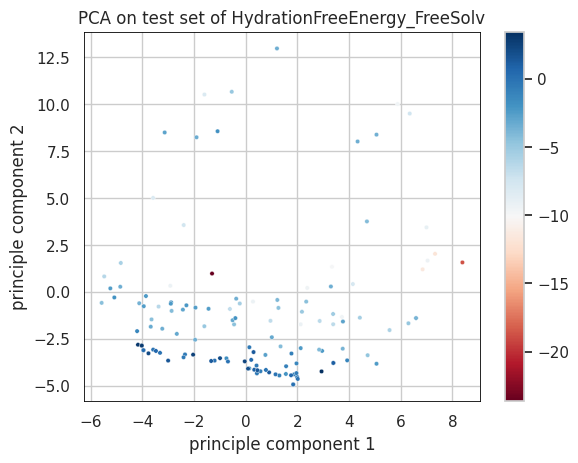

---> converting SMILES to MACCS...
---> FINISHED
figure saved at PCA/PCA on data set of HydrationFreeEnergy_FreeSolv.png


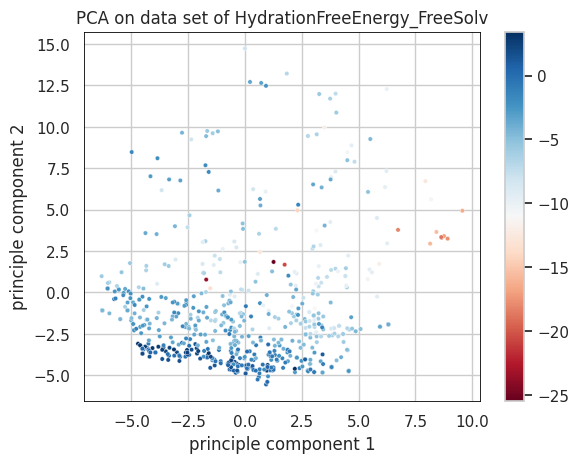

Found local copy...
Loading...
Done!


---> converting SMILES to MACCS...
---> FINISHED
figure saved at PCA/PCA on train set of Solubility_AqSolDB.png


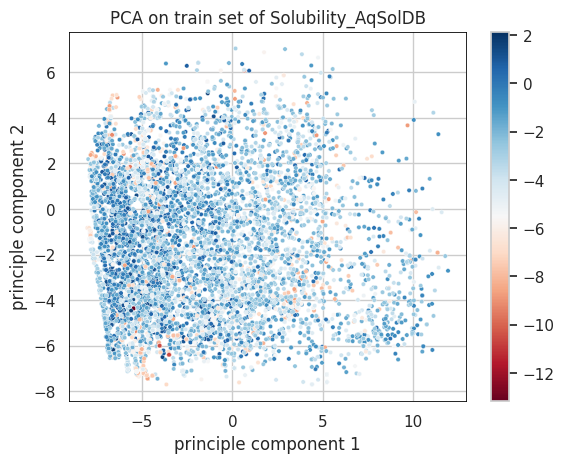

---> converting SMILES to MACCS...
---> FINISHED
figure saved at PCA/PCA on valid set of Solubility_AqSolDB.png


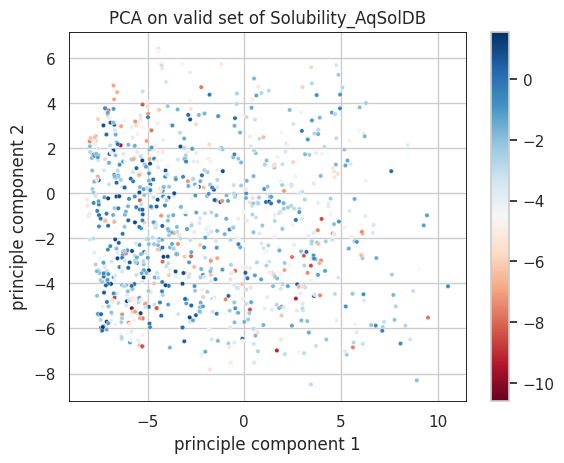

---> converting SMILES to MACCS...
---> FINISHED
figure saved at PCA/PCA on test set of Solubility_AqSolDB.png


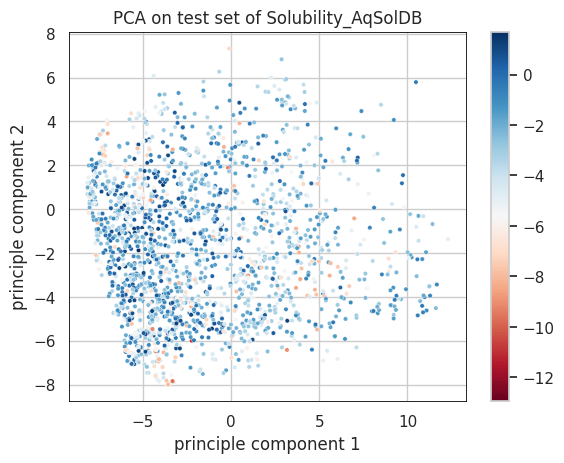

---> converting SMILES to MACCS...
---> FINISHED
figure saved at PCA/PCA on data set of Solubility_AqSolDB.png


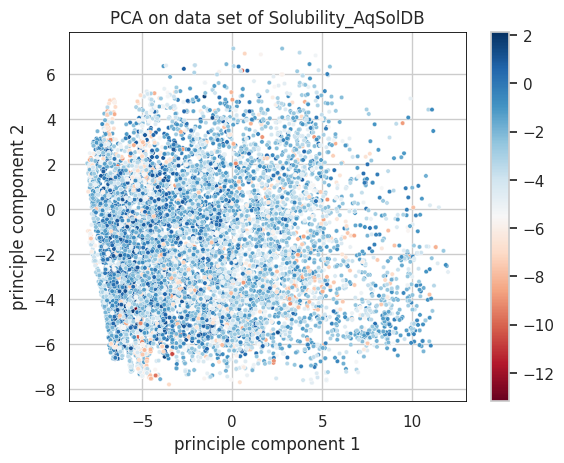

Found local copy...
Loading...
Done!


---> converting SMILES to MACCS...
---> FINISHED
figure saved at PCA/PCA on train set of LD50_Zhu.png


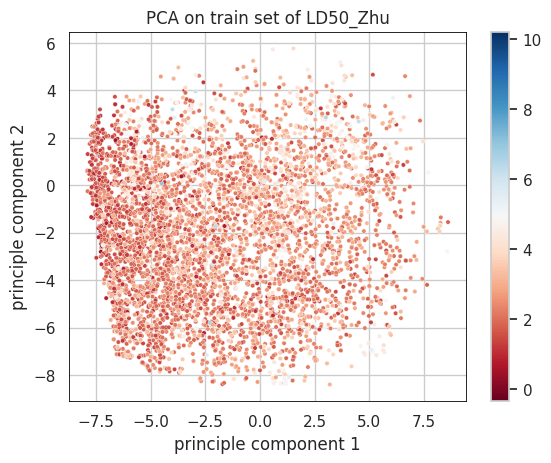

---> converting SMILES to MACCS...
---> FINISHED
figure saved at PCA/PCA on valid set of LD50_Zhu.png


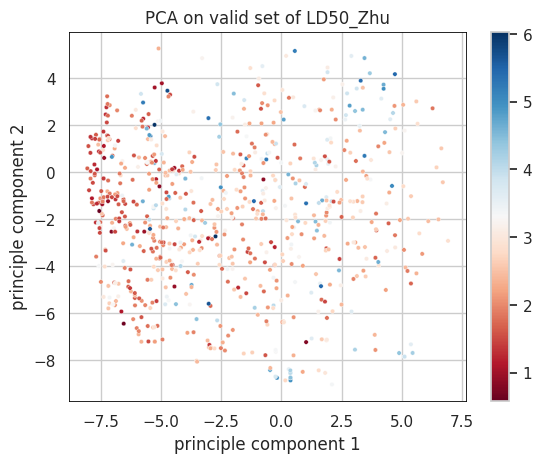

---> converting SMILES to MACCS...
---> FINISHED
figure saved at PCA/PCA on test set of LD50_Zhu.png


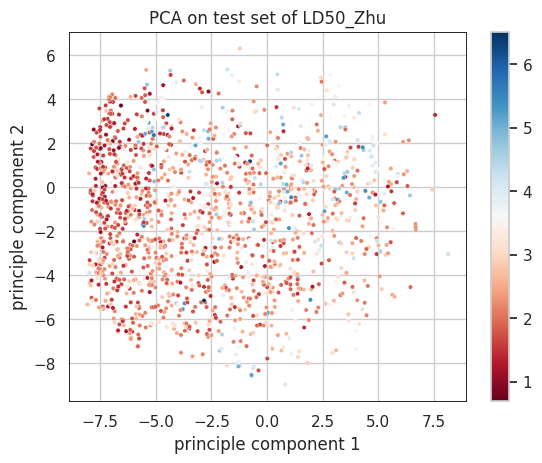

---> converting SMILES to MACCS...
---> FINISHED
figure saved at PCA/PCA on data set of LD50_Zhu.png


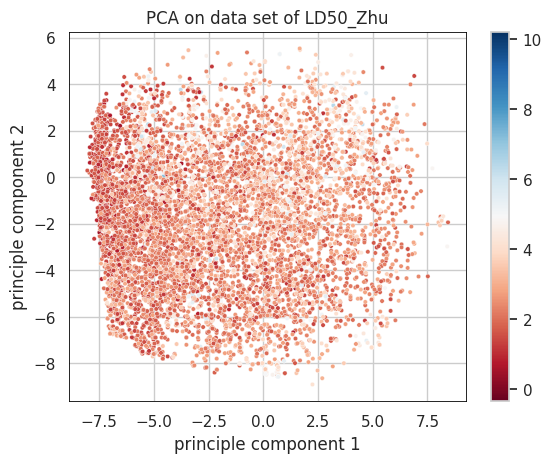

Found local copy...
Loading...
Done!


---> converting SMILES to MACCS...
---> FINISHED
figure saved at PCA/PCA on train set of CYP2C19_Veith.png


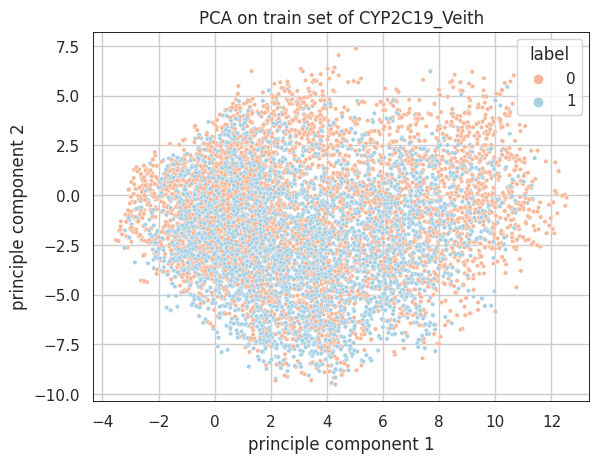

---> converting SMILES to MACCS...
---> FINISHED
figure saved at PCA/PCA on valid set of CYP2C19_Veith.png


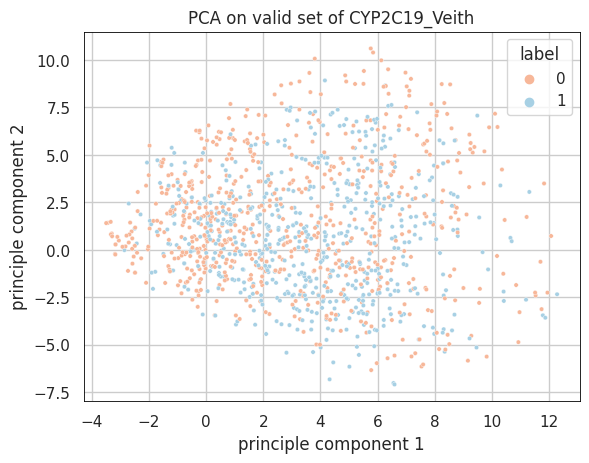

---> converting SMILES to MACCS...
---> FINISHED
figure saved at PCA/PCA on test set of CYP2C19_Veith.png


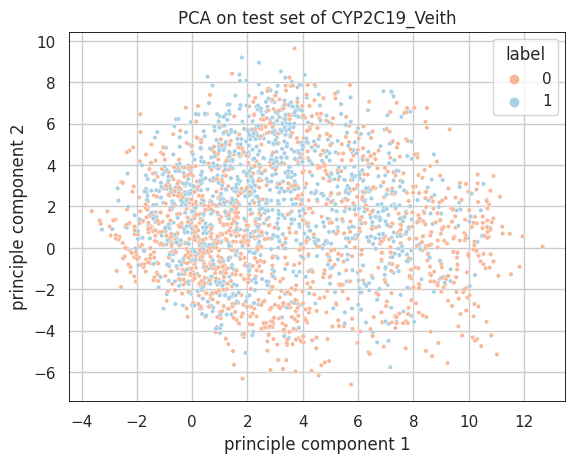

---> converting SMILES to MACCS...
---> FINISHED
figure saved at PCA/PCA on data set of CYP2C19_Veith.png


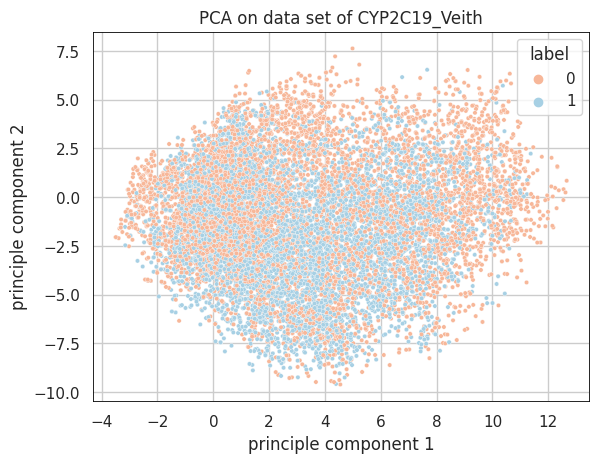

Found local copy...
Loading...
Done!


---> converting SMILES to MACCS...
---> FINISHED
figure saved at PCA/PCA on train set of CYP2D6_Veith.png


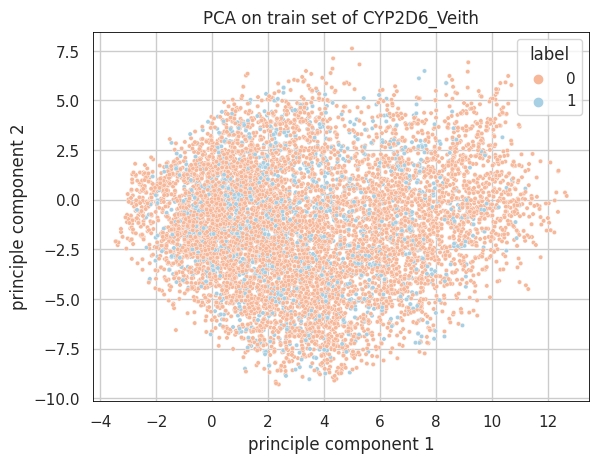

---> converting SMILES to MACCS...
---> FINISHED
figure saved at PCA/PCA on valid set of CYP2D6_Veith.png


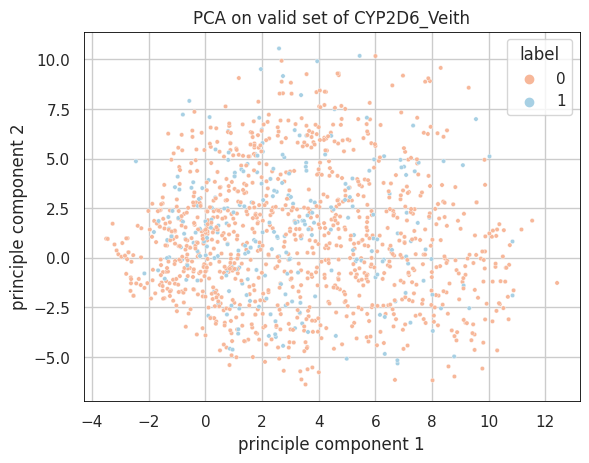

---> converting SMILES to MACCS...
---> FINISHED
figure saved at PCA/PCA on test set of CYP2D6_Veith.png


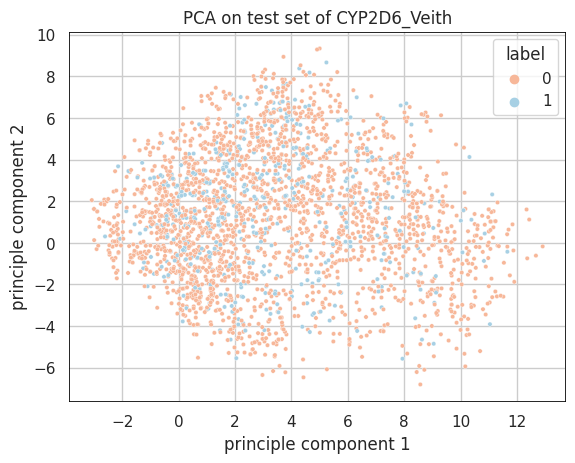

---> converting SMILES to MACCS...
---> FINISHED
figure saved at PCA/PCA on data set of CYP2D6_Veith.png


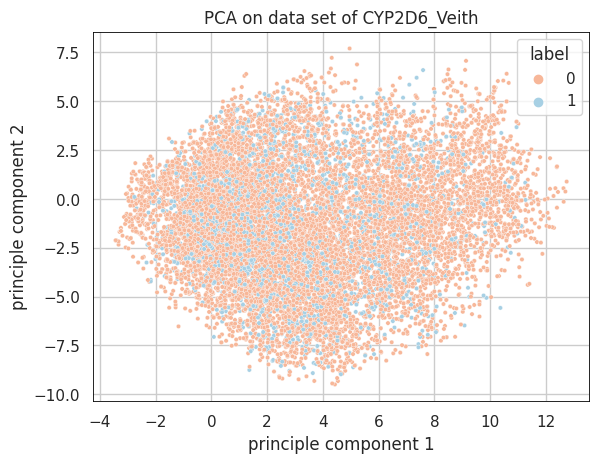

Found local copy...
Loading...
Done!


---> converting SMILES to MACCS...
---> FINISHED
figure saved at PCA/PCA on train set of CYP3A4_Veith.png


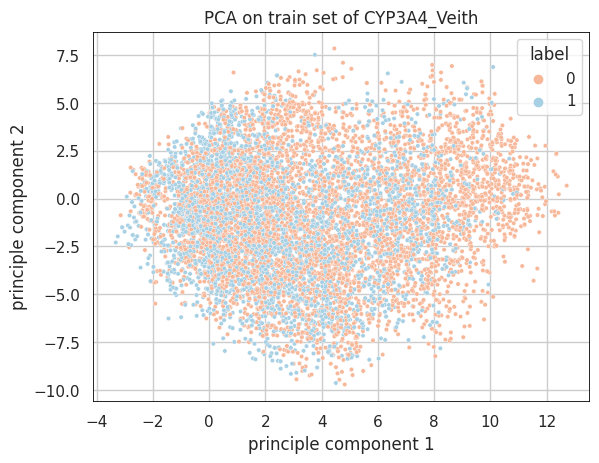

---> converting SMILES to MACCS...
---> FINISHED
figure saved at PCA/PCA on valid set of CYP3A4_Veith.png


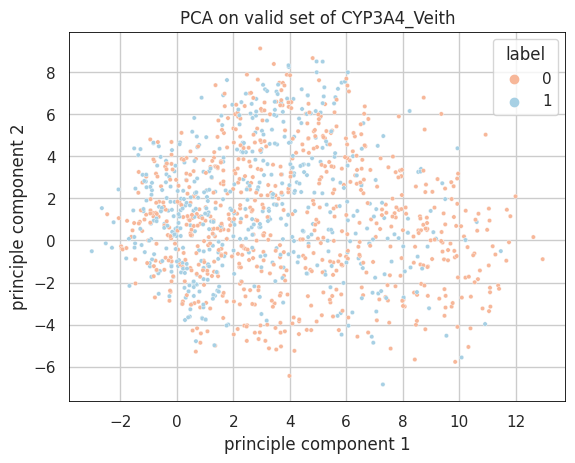

---> converting SMILES to MACCS...
---> FINISHED
figure saved at PCA/PCA on test set of CYP3A4_Veith.png


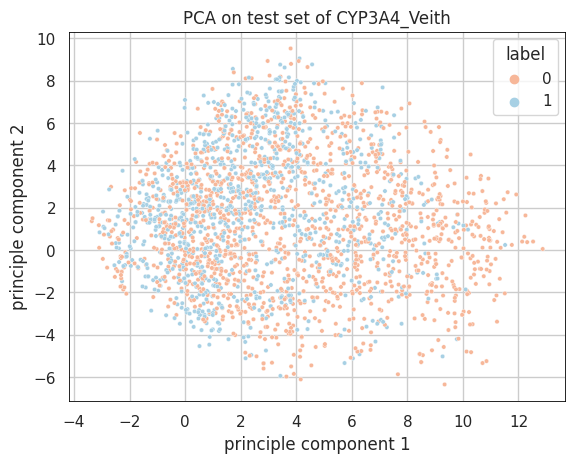

---> converting SMILES to MACCS...
---> FINISHED
figure saved at PCA/PCA on data set of CYP3A4_Veith.png


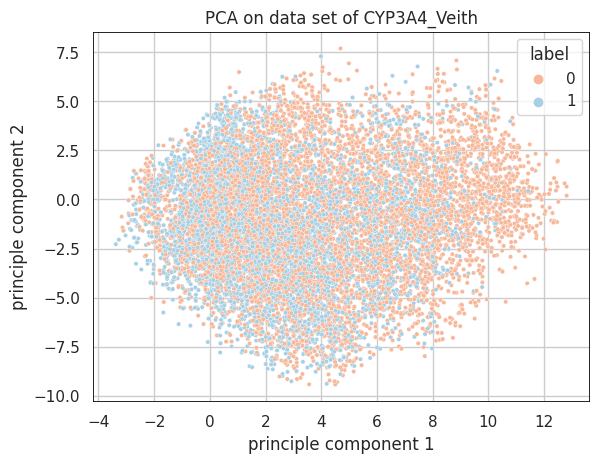

Found local copy...
Loading...
Done!


---> converting SMILES to MACCS...
---> FINISHED
figure saved at PCA/PCA on train set of CYP1A2_Veith.png


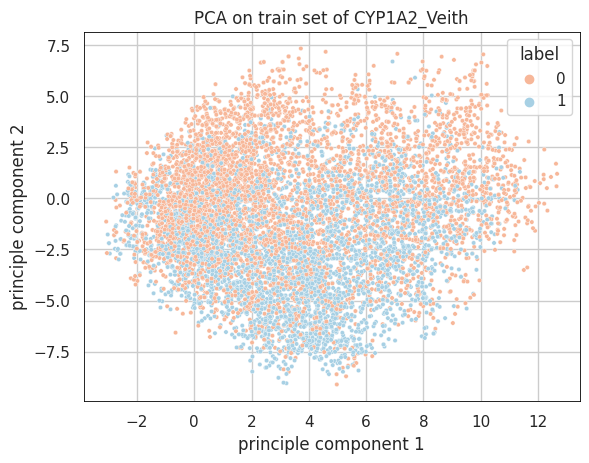

---> converting SMILES to MACCS...
---> FINISHED
figure saved at PCA/PCA on valid set of CYP1A2_Veith.png


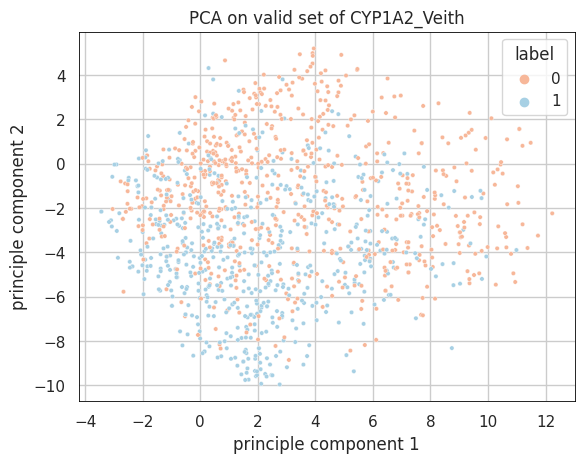

---> converting SMILES to MACCS...
---> FINISHED
figure saved at PCA/PCA on test set of CYP1A2_Veith.png


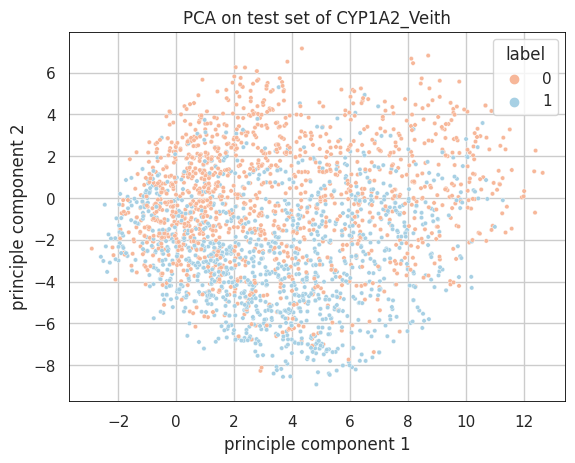

---> converting SMILES to MACCS...
---> FINISHED
figure saved at PCA/PCA on data set of CYP1A2_Veith.png


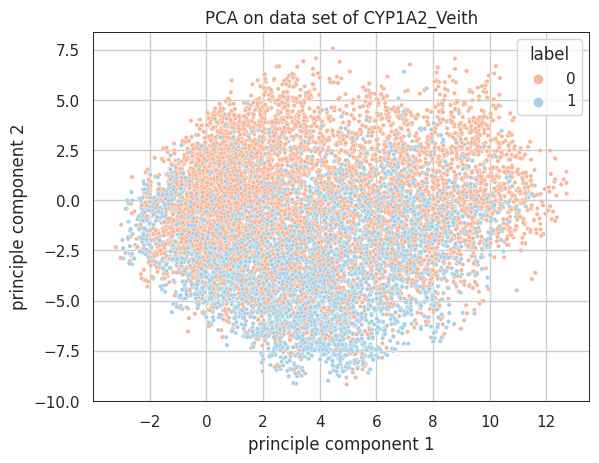

Found local copy...
Loading...
Done!


---> converting SMILES to MACCS...
---> FINISHED
figure saved at PCA/PCA on train set of CYP2C9_Veith.png


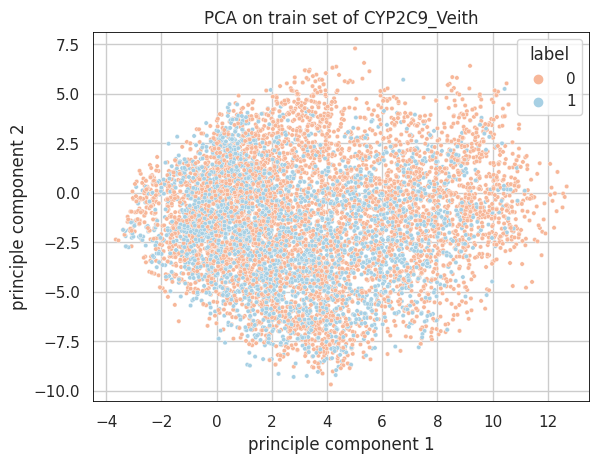

---> converting SMILES to MACCS...
---> FINISHED
figure saved at PCA/PCA on valid set of CYP2C9_Veith.png


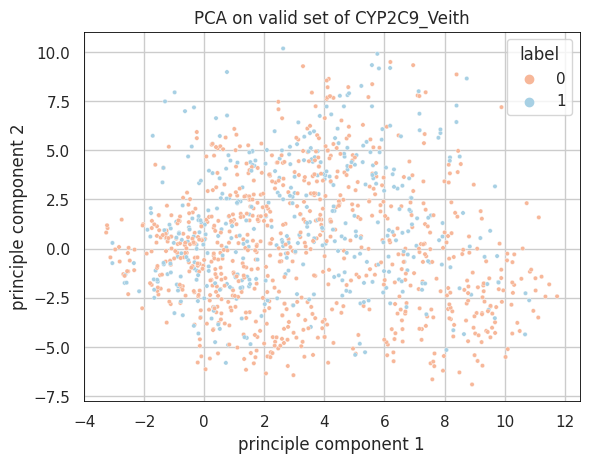

---> converting SMILES to MACCS...
---> FINISHED
figure saved at PCA/PCA on test set of CYP2C9_Veith.png


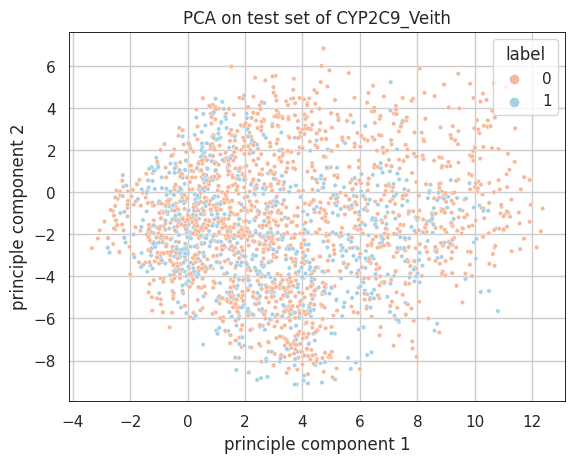

---> converting SMILES to MACCS...
---> FINISHED
figure saved at PCA/PCA on data set of CYP2C9_Veith.png


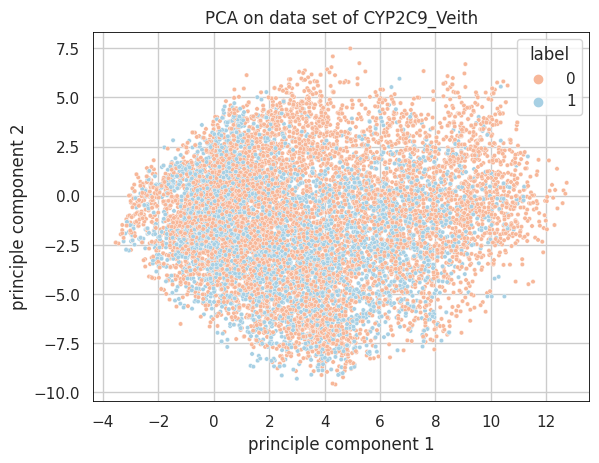

Found local copy...
Loading...
Done!


---> converting SMILES to MACCS...
---> FINISHED
figure saved at PCA/PCA on train set of BBB_Martins.png


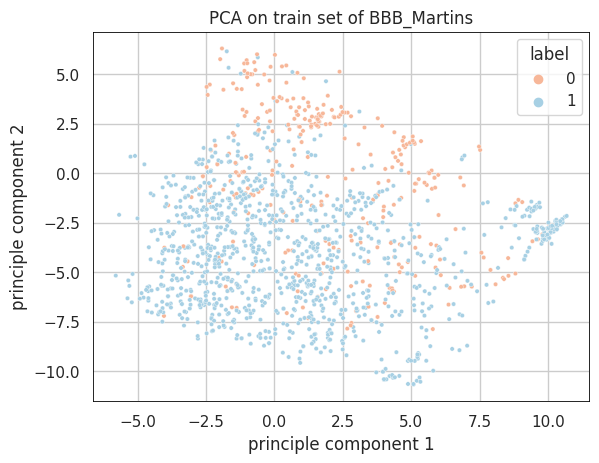

---> converting SMILES to MACCS...
---> FINISHED
figure saved at PCA/PCA on valid set of BBB_Martins.png


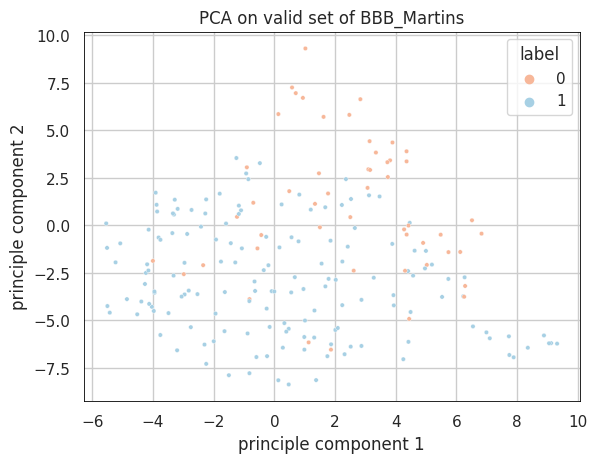

---> converting SMILES to MACCS...
---> FINISHED
figure saved at PCA/PCA on test set of BBB_Martins.png


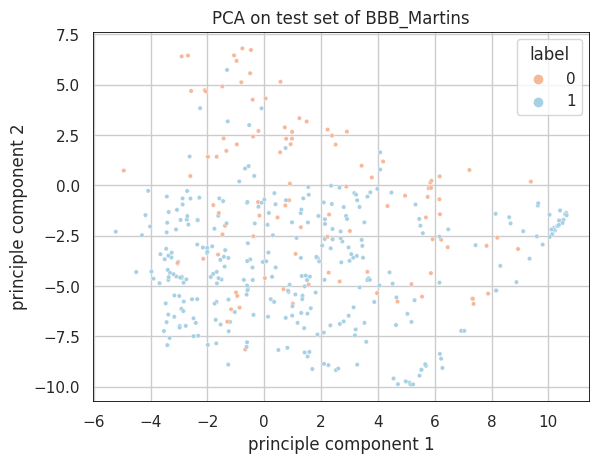

---> converting SMILES to MACCS...
---> FINISHED
figure saved at PCA/PCA on data set of BBB_Martins.png


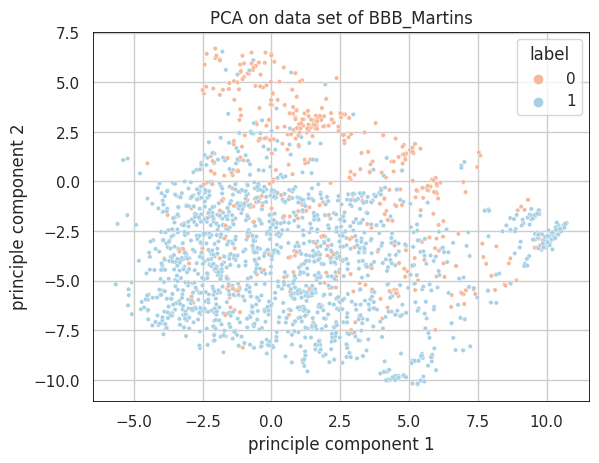

Found local copy...
Loading...
Done!


---> converting SMILES to MACCS...
---> FINISHED
figure saved at PCA/PCA on train set of Bioavailability_Ma.png


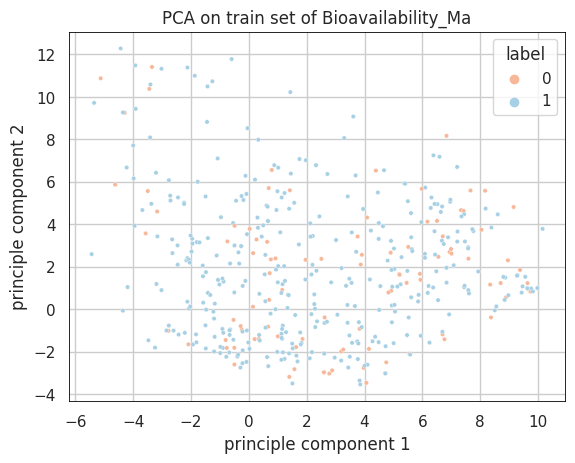

---> converting SMILES to MACCS...
---> FINISHED
figure saved at PCA/PCA on valid set of Bioavailability_Ma.png


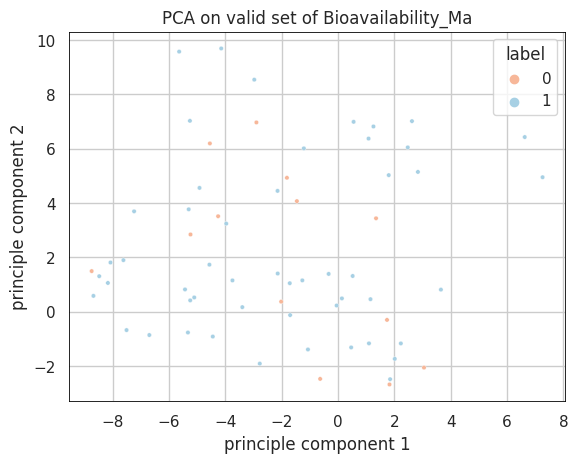

---> converting SMILES to MACCS...
---> FINISHED
figure saved at PCA/PCA on test set of Bioavailability_Ma.png


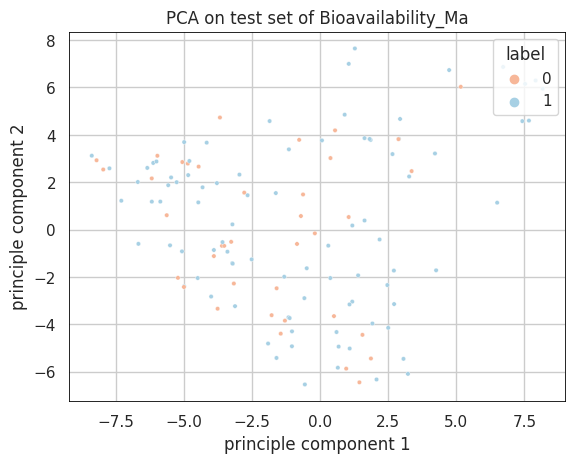

---> converting SMILES to MACCS...
---> FINISHED
figure saved at PCA/PCA on data set of Bioavailability_Ma.png


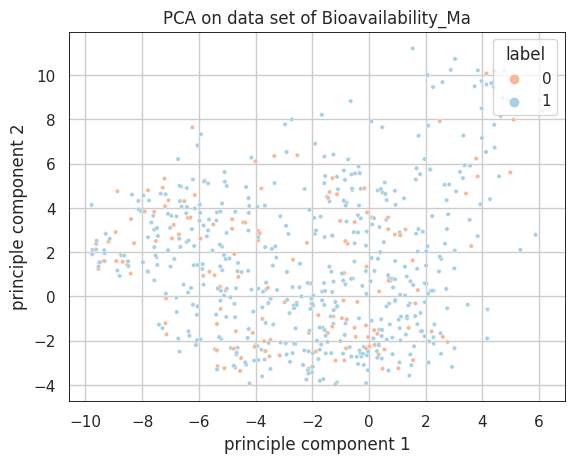

Found local copy...
Loading...
Done!


---> converting SMILES to MACCS...
---> FINISHED
figure saved at PCA/PCA on train set of Pgp_Broccatelli.png


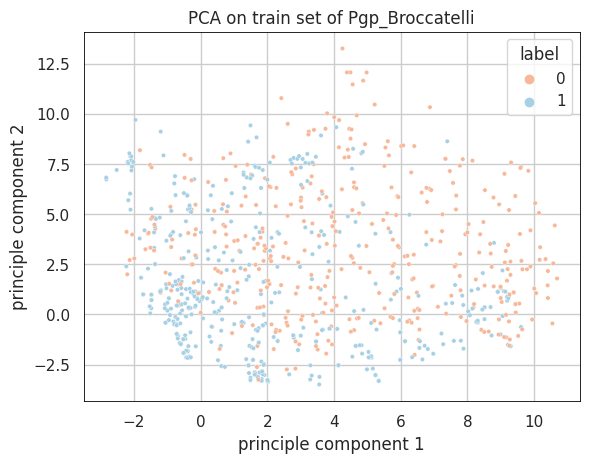

---> converting SMILES to MACCS...
---> FINISHED
figure saved at PCA/PCA on valid set of Pgp_Broccatelli.png


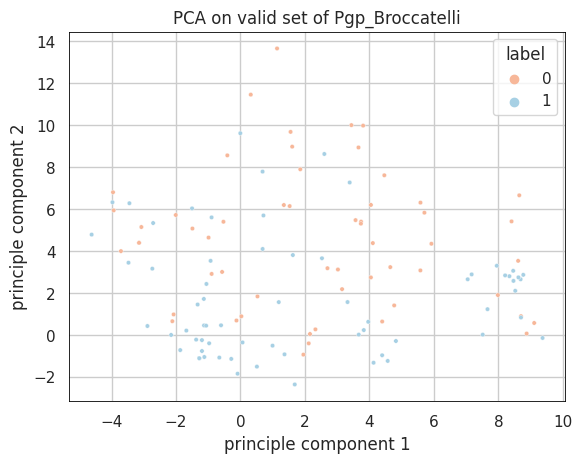

---> converting SMILES to MACCS...
---> FINISHED
figure saved at PCA/PCA on test set of Pgp_Broccatelli.png


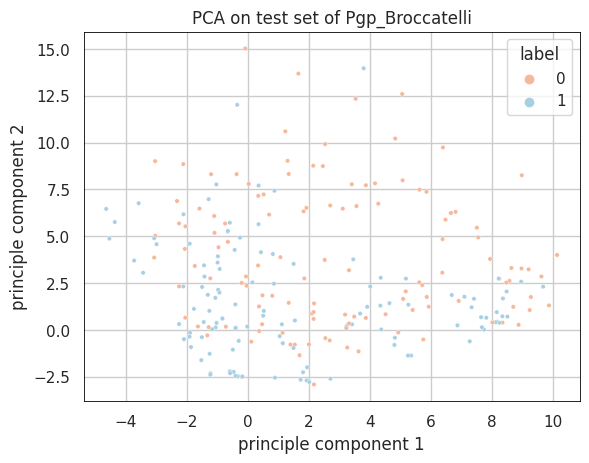

---> converting SMILES to MACCS...
---> FINISHED
figure saved at PCA/PCA on data set of Pgp_Broccatelli.png


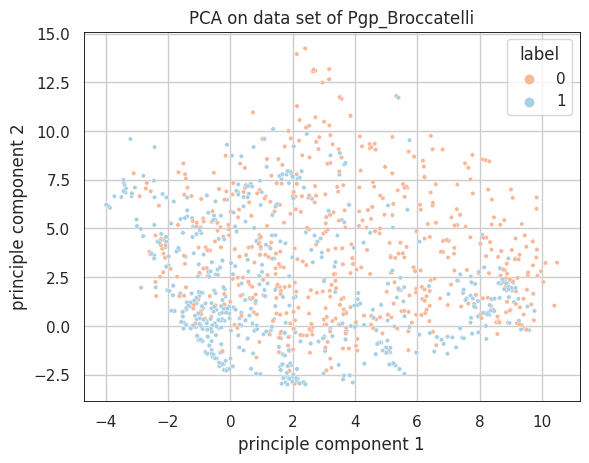

Found local copy...
Loading...
Done!


---> converting SMILES to MACCS...
---> FINISHED
figure saved at PCA/PCA on train set of HIA_Hou.png


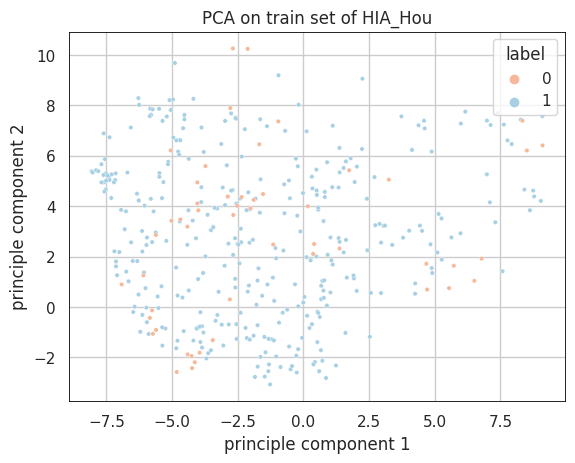

---> converting SMILES to MACCS...
---> FINISHED
figure saved at PCA/PCA on valid set of HIA_Hou.png


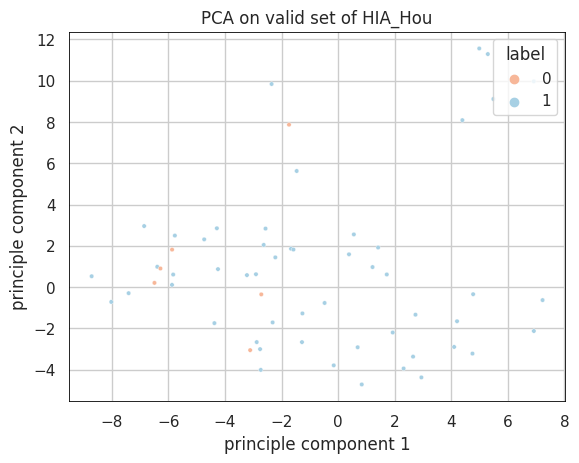

---> converting SMILES to MACCS...
---> FINISHED
figure saved at PCA/PCA on test set of HIA_Hou.png


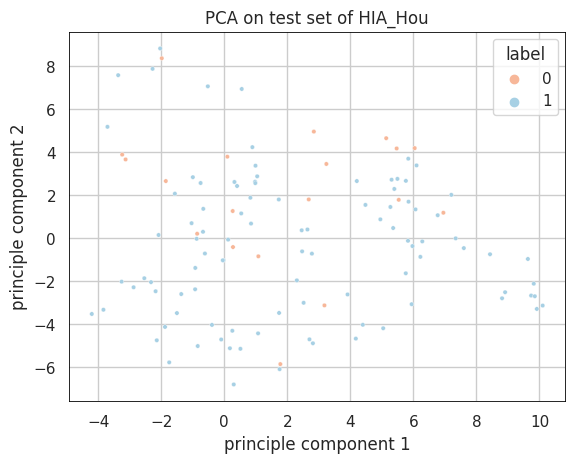

---> converting SMILES to MACCS...
---> FINISHED
figure saved at PCA/PCA on data set of HIA_Hou.png


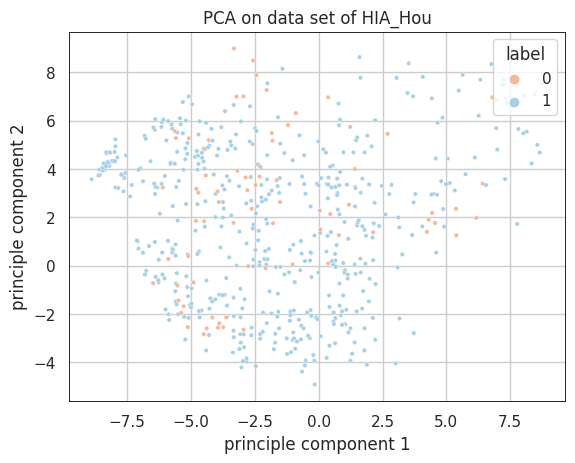

Found local copy...
Loading...
Done!


---> converting SMILES to MACCS...
---> FINISHED
figure saved at PCA/PCA on train set of PAMPA_NCATS.png


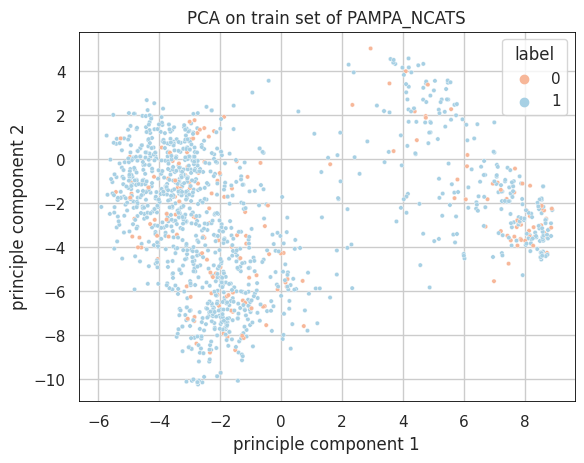

---> converting SMILES to MACCS...
---> FINISHED
figure saved at PCA/PCA on valid set of PAMPA_NCATS.png


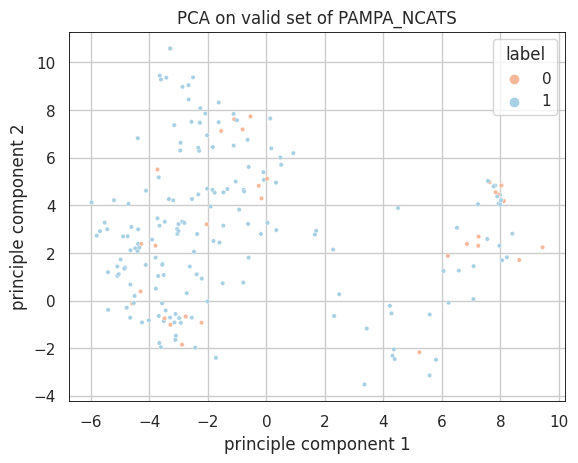

---> converting SMILES to MACCS...
---> FINISHED
figure saved at PCA/PCA on test set of PAMPA_NCATS.png


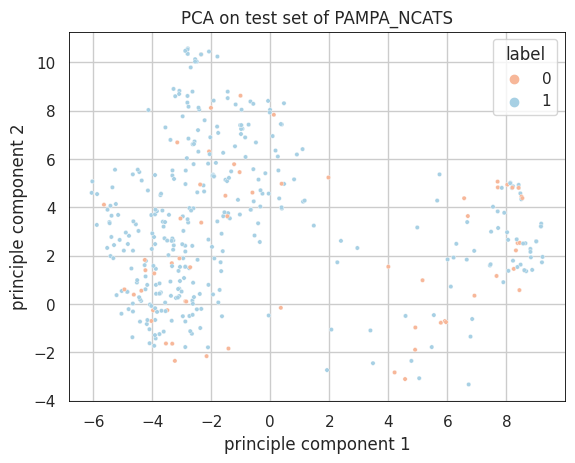

---> converting SMILES to MACCS...
---> FINISHED
figure saved at PCA/PCA on data set of PAMPA_NCATS.png


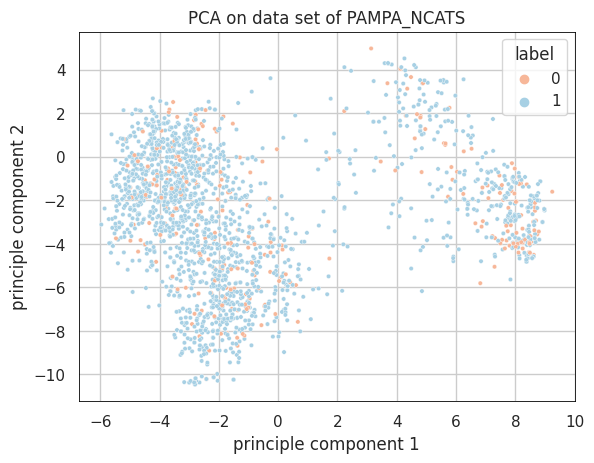

Found local copy...
Loading...
Done!


---> converting SMILES to MACCS...
---> FINISHED
figure saved at PCA/PCA on train set of hERG_Karim.png


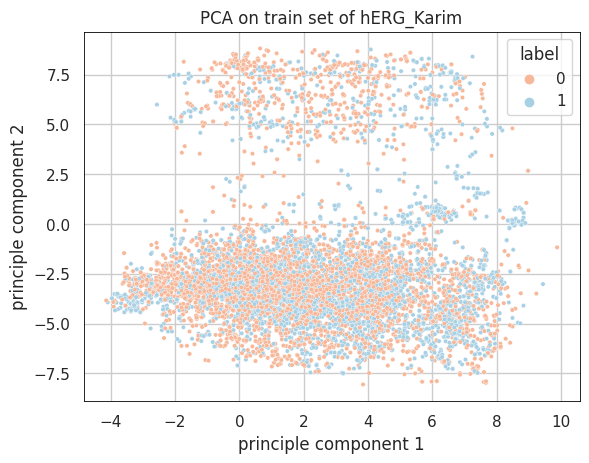

---> converting SMILES to MACCS...
---> FINISHED
figure saved at PCA/PCA on valid set of hERG_Karim.png


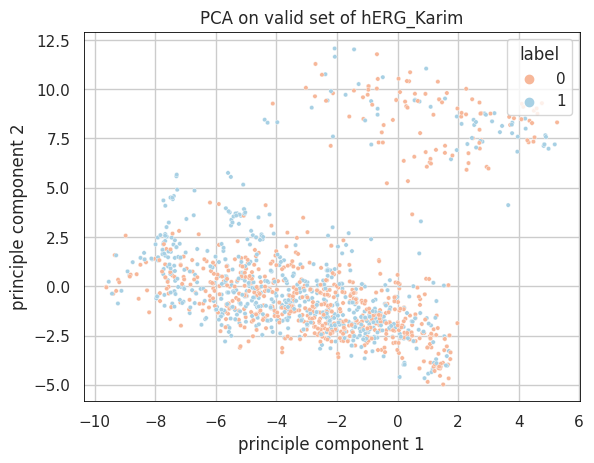

---> converting SMILES to MACCS...
---> FINISHED
figure saved at PCA/PCA on test set of hERG_Karim.png


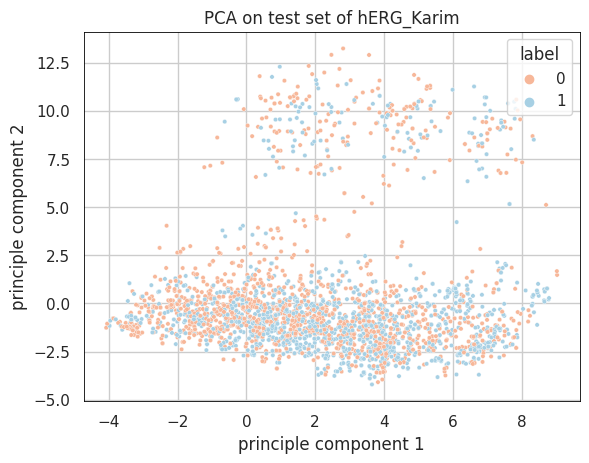

---> converting SMILES to MACCS...
---> FINISHED
figure saved at PCA/PCA on data set of hERG_Karim.png


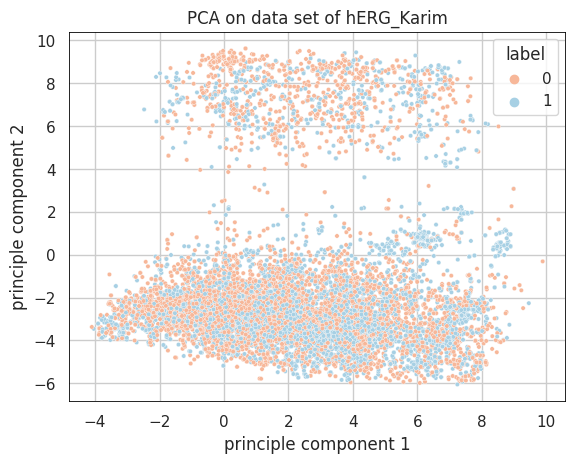

Found local copy...
Loading...
Done!


---> converting SMILES to MACCS...
---> FINISHED
figure saved at PCA/PCA on train set of AMES.png


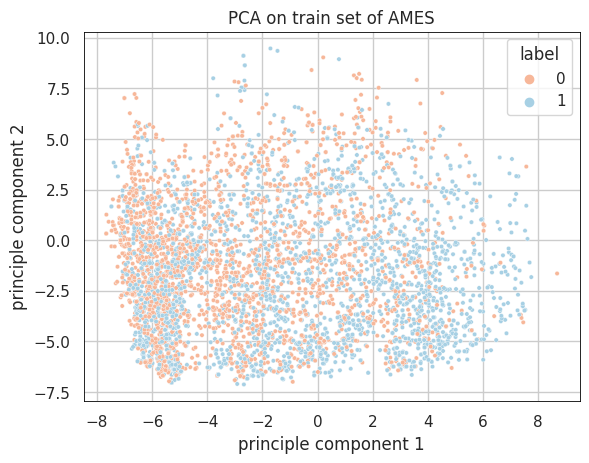

---> converting SMILES to MACCS...
---> FINISHED
figure saved at PCA/PCA on valid set of AMES.png


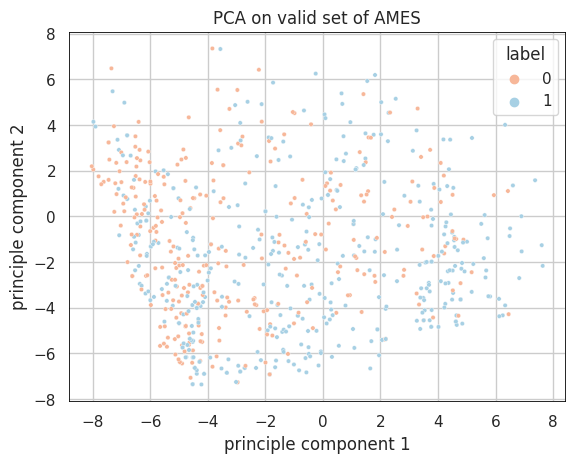

---> converting SMILES to MACCS...
---> FINISHED
figure saved at PCA/PCA on test set of AMES.png


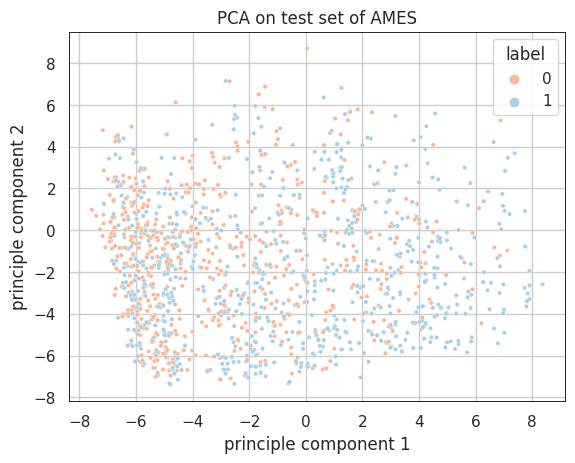

---> converting SMILES to MACCS...
---> FINISHED
figure saved at PCA/PCA on data set of AMES.png


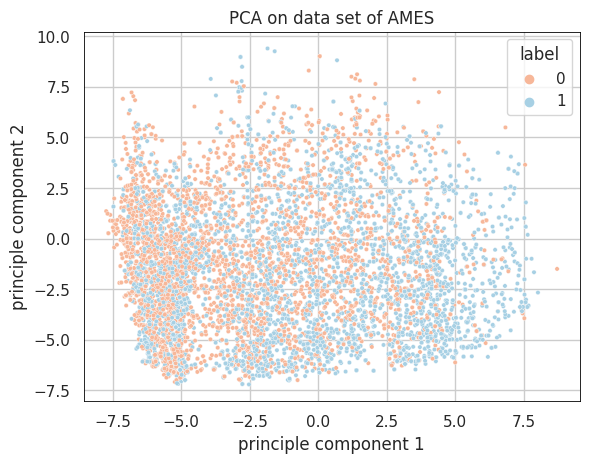

In [67]:

for name, IS_R in names_dict.items():
    # if IS_R == False: # classification task
    trains, valids, tests = collect_data_10_24([name], show_dist=False)
    df_all   = pd.concat([trains, valids, tests], ignore_index=True, axis=0)
    data_list = [trains, valids, tests, df_all]
    desc_list = ['train set', 'valid set', 'test set', 'data set']
    for (data, desc) in zip(data_list, desc_list):
        data = process(data)
        features, labels = data[header], data[name]
        assert features.shape[0] == len(labels)
        for dim_reduct in ['PCA', 't-SNE']:
            title = f'{dim_reduct} on {desc} of {name}'
            # if dim_reduct == 'PCA':
            plot_dim_reduced(features, labels, IS_R, dim_reduct, title)


  0%|          | 0/17 [00:00<?, ?it/s]

path: GRID_GRAPHS is created


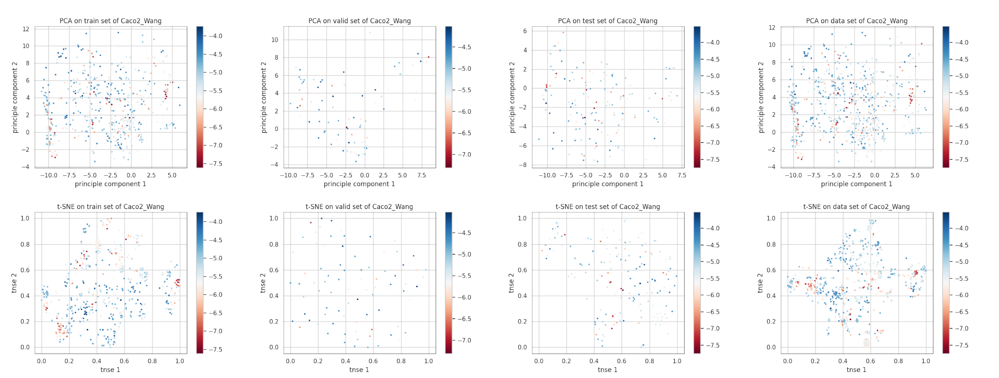

  6%|▌         | 1/17 [00:07<02:07,  7.95s/it]

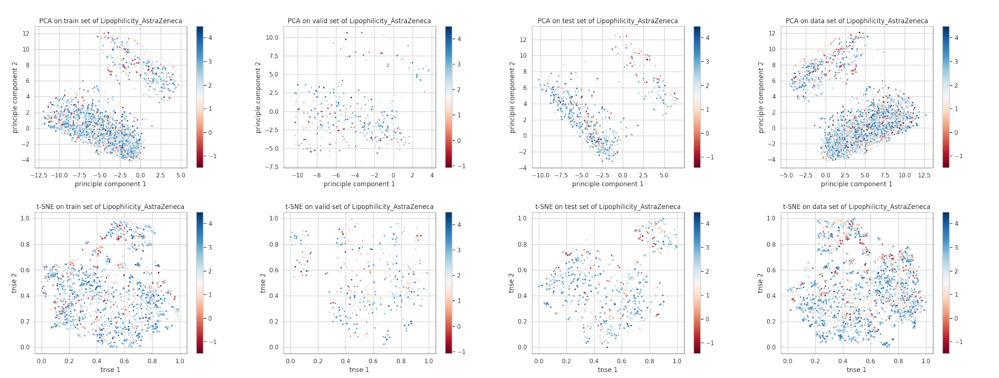

 12%|█▏        | 2/17 [00:15<01:56,  7.77s/it]

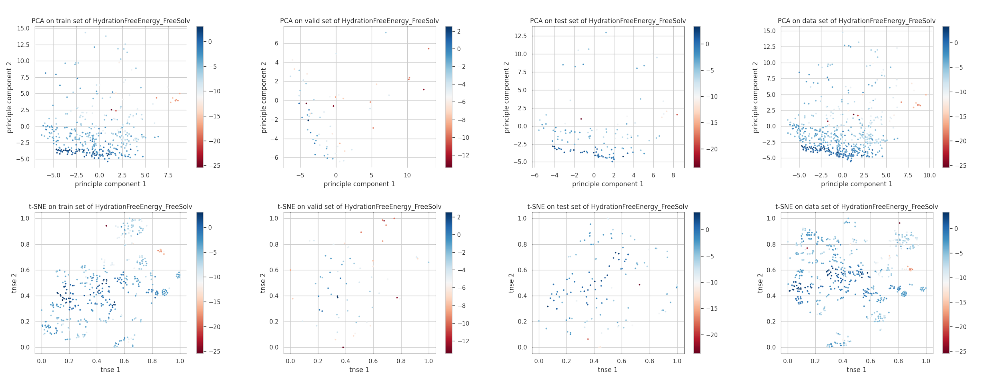

 18%|█▊        | 3/17 [00:23<01:48,  7.73s/it]

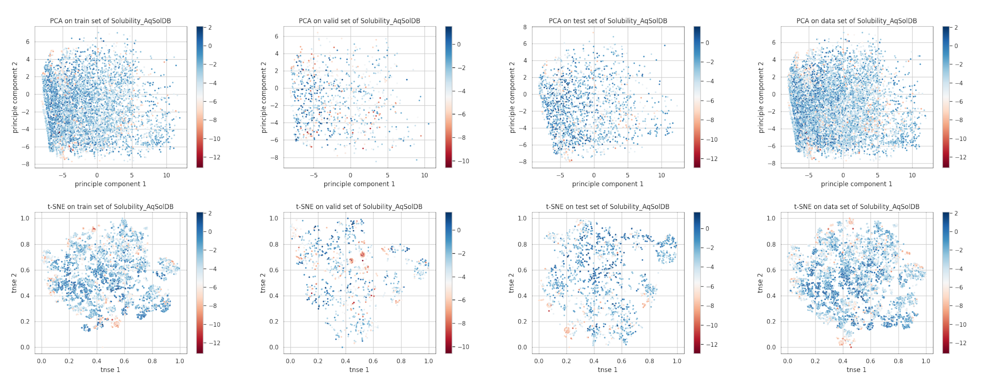

 24%|██▎       | 4/17 [00:30<01:35,  7.37s/it]

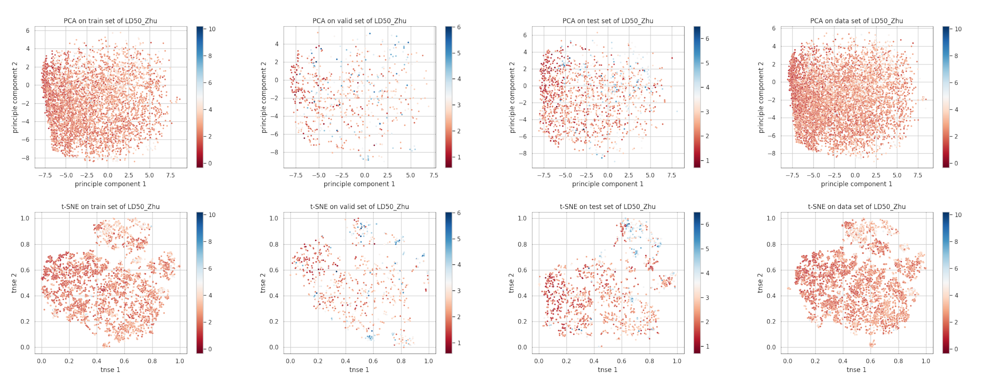

 29%|██▉       | 5/17 [00:38<01:32,  7.75s/it]

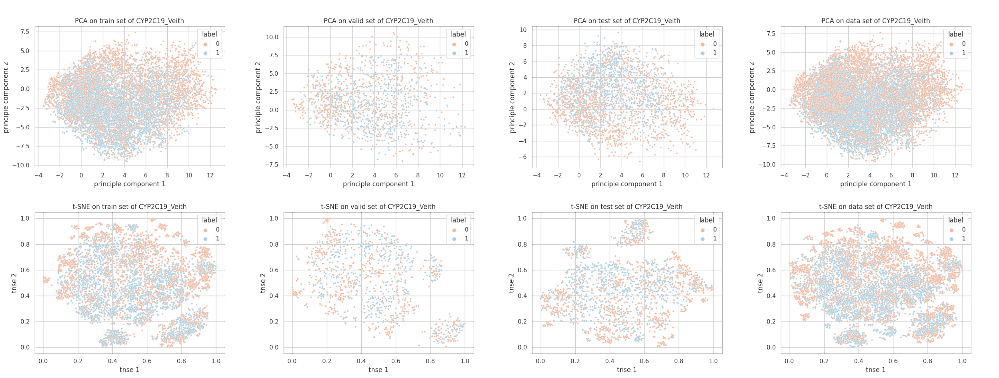

 35%|███▌      | 6/17 [00:45<01:22,  7.52s/it]

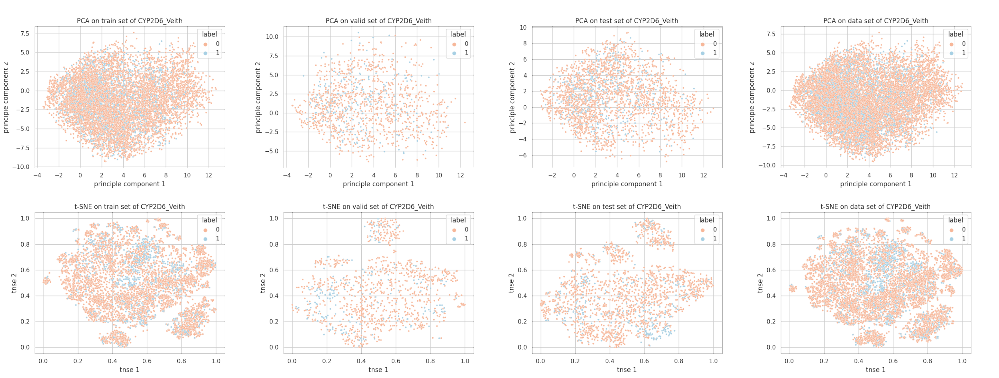

 41%|████      | 7/17 [00:54<01:18,  7.87s/it]

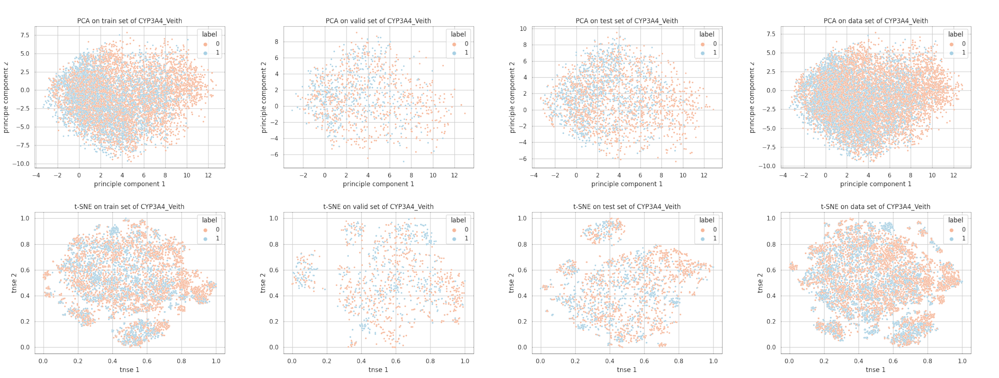

 47%|████▋     | 8/17 [01:01<01:08,  7.66s/it]

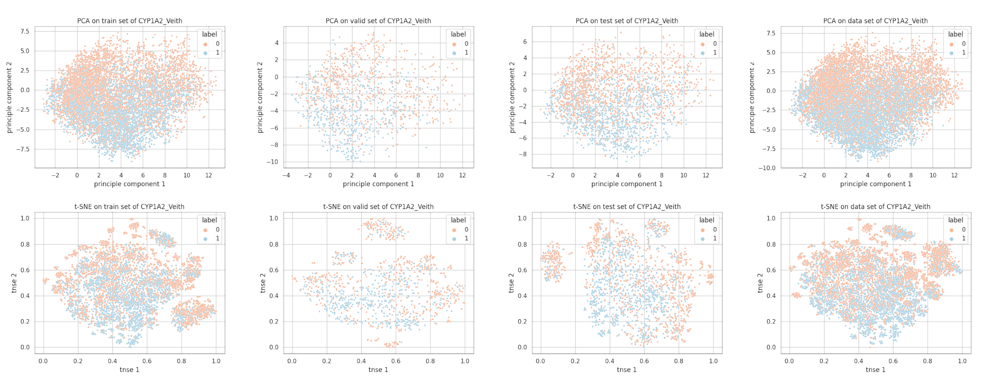

 53%|█████▎    | 9/17 [01:10<01:03,  7.99s/it]

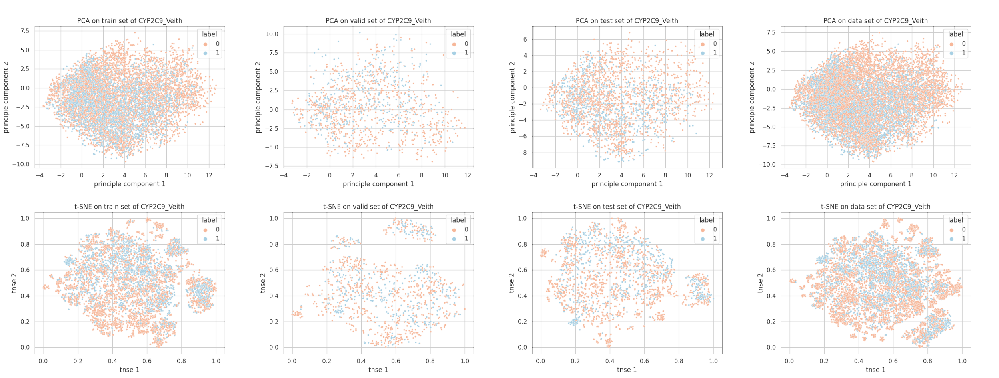

 59%|█████▉    | 10/17 [01:17<00:54,  7.76s/it]

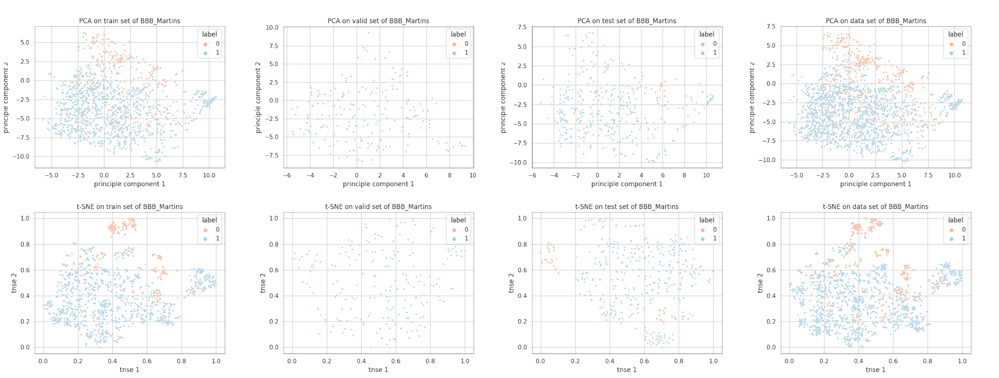

 65%|██████▍   | 11/17 [01:25<00:47,  7.97s/it]

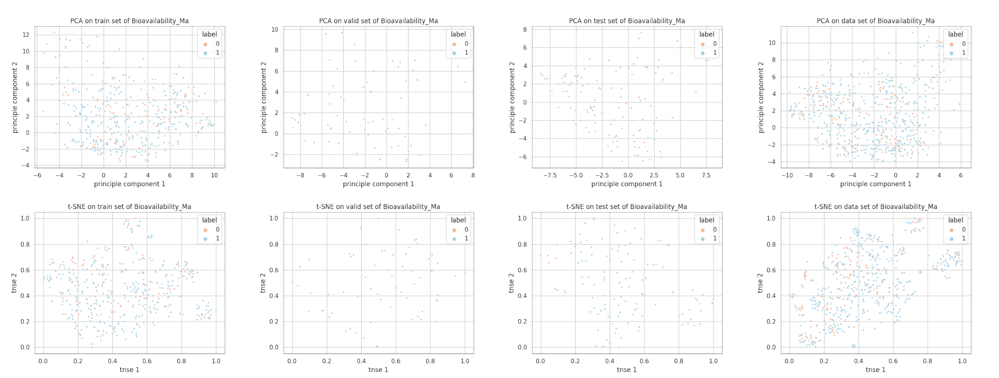

 71%|███████   | 12/17 [01:32<00:37,  7.46s/it]

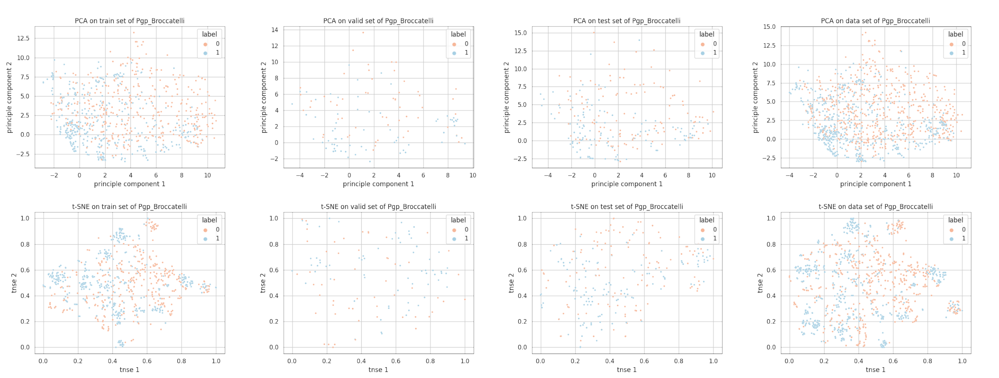

 76%|███████▋  | 13/17 [01:40<00:31,  7.76s/it]

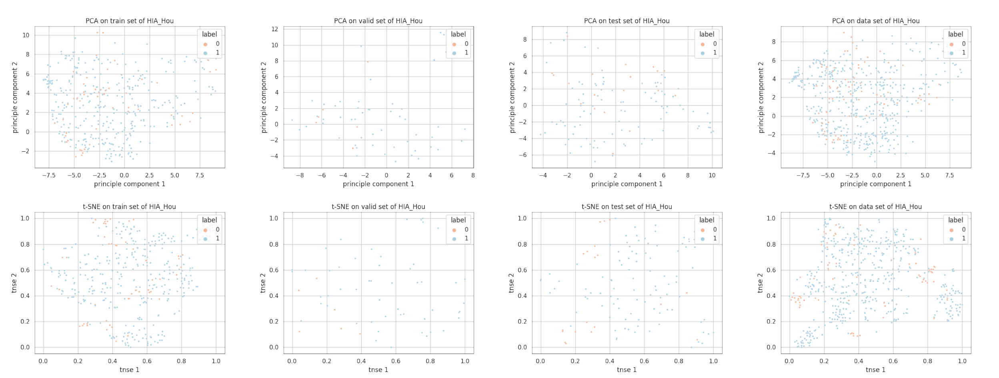

 82%|████████▏ | 14/17 [01:47<00:22,  7.64s/it]

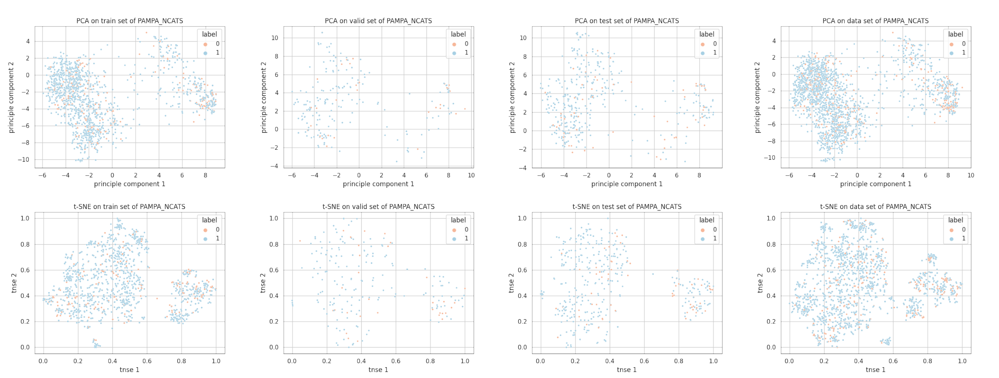

 88%|████████▊ | 15/17 [01:56<00:15,  7.84s/it]

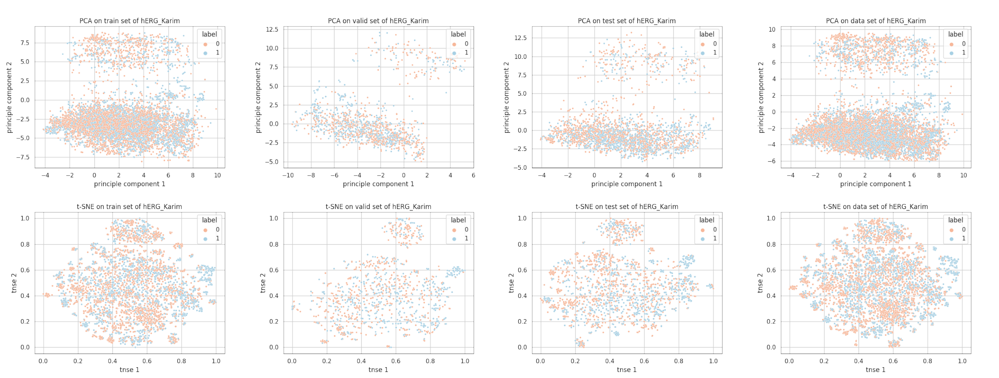

 94%|█████████▍| 16/17 [02:03<00:07,  7.57s/it]

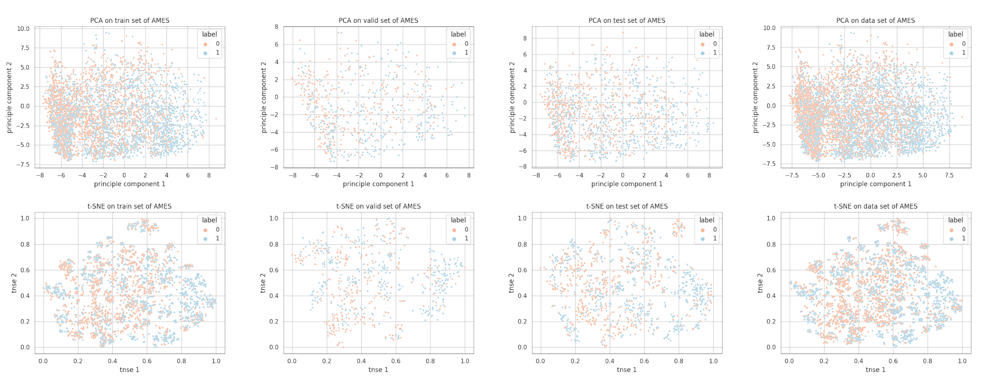

100%|██████████| 17/17 [02:13<00:00,  7.88s/it]


In [68]:
names_plot = names_all
for name in tqdm(names_plot, total=len(names_plot)):
    fig, axes = plt.subplots(len(reduction), len(desc_list),
                         figsize=(width*len(desc_list),
                                  heigh*len(reduction))) #(w,h))
    for i, dim_reduct in enumerate(reduction):
        for j, desc in enumerate(desc_list):
            ax = axes[i, j]
            title = f'{dim_reduct} on {desc} of {name}'
            # print(title)
            img_path = f'{dim_reduct}/{title}.png'
            # print(img_path)
            image = Image.open(img_path)
            # ax.imshow(image)
            ax.axis('off'); ax.imshow(image)
    plt.subplots_adjust(wspace=0.01, hspace=0.01)
    make_path('GRID_GRAPHS', False)
    save_dir = f'GRID_GRAPHS/{name}_PCA_TSNE.png'
    plt.savefig(save_dir, dpi=400, format='png', transparent=True)
    print('save fig at', save_dir)
    plt.show(); plt.close()
    # plt.subplots_adjust(bottom=.01)

100%|██████████| 17/17 [00:01<00:00, 16.92it/s]


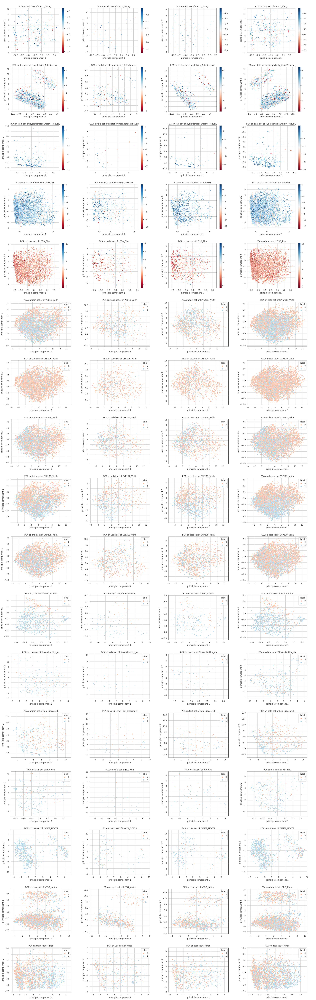

In [69]:
from tqdm import tqdm
from PIL import Image

names_all = list(names_dict.keys())
desc_list = ['train set', 'valid set', 'test set', 'data set']
reduction = ['PCA', 't-SNE']

"""For single plot, set the width and height"""
width = 8
heigh = 6

names_plot = names_all

fig, axes = plt.subplots(len(names_plot), len(desc_list),
                         figsize=(width*len(desc_list),
                                  heigh*len(names_plot))) #(w,h))

for i, name in tqdm(enumerate(names_plot), total=len(names_plot)):
    for j, desc in enumerate(desc_list):
    # for dim_reduct in reduction:
        dim_reduct = 'PCA'
        ax = axes[i, j]
        title = f'{dim_reduct} on {desc} of {name}'
        img_path = f'{dim_reduct}/{title}.png'
        image = Image.open(img_path)
        # ax.imshow(image)
        ax.axis('off'); ax.imshow(image)
plt.subplots_adjust(wspace=0.01, hspace=0.01)
make_path('GRID_GRAPHS', False)
plt.savefig(f'GRID_GRAPHS/demo.png', format='png', transparent=True)
plt.show(); plt.close()
# plt.subplots_adjust(bottom=.01)